# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [7]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [8]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.5,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
    encode_covariates = False,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-2,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    "afriat_v2_4_encode_2"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: 8sys56jq
Name: carbonite-transport-131
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/8sys56jq
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-8sys56jq/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2546,3285,9412
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2546,2591,1673,3434,1629,3370
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4454,10789
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 659,824,2327
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 659,611,435,856,420,829
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1130,2680
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:13<2:11:55, 13.22s/it]

Epoch 1/600:   0%|          | 1/600 [00:13<2:11:55, 13.22s/it, v_num=jq_1, total_loss_train=3.66e+3, kl_local_train=44]

Epoch 2/600:   0%|          | 1/600 [00:13<2:11:55, 13.22s/it, v_num=jq_1, total_loss_train=3.66e+3, kl_local_train=44]

Epoch 2/600:   0%|          | 2/600 [00:25<2:04:55, 12.53s/it, v_num=jq_1, total_loss_train=3.66e+3, kl_local_train=44]

Epoch 2/600:   0%|          | 2/600 [00:25<2:04:55, 12.53s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=67.9]

Epoch 3/600:   0%|          | 2/600 [00:25<2:04:55, 12.53s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=67.9]

Epoch 3/600:   0%|          | 3/600 [00:37<2:02:19, 12.29s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=67.9]

Epoch 3/600:   0%|          | 3/600 [00:37<2:02:19, 12.29s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=70.1]

Epoch 4/600:   0%|          | 3/600 [00:37<2:02:19, 12.29s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=70.1]

Epoch 4/600:   1%|          | 4/600 [00:49<2:00:25, 12.12s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=70.1]

Epoch 4/600:   1%|          | 4/600 [00:49<2:00:25, 12.12s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=68.8]

Epoch 5/600:   1%|          | 4/600 [00:49<2:00:25, 12.12s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=68.8]

Epoch 5/600:   1%|          | 5/600 [01:01<1:59:56, 12.10s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=68.8]

Epoch 5/600:   1%|          | 5/600 [01:01<1:59:56, 12.10s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=64.8]

Epoch 6/600:   1%|          | 5/600 [01:02<1:59:56, 12.10s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=64.8]

Epoch 6/600:   1%|          | 6/600 [01:13<2:01:54, 12.31s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=64.8]

Epoch 6/600:   1%|          | 6/600 [01:13<2:01:54, 12.31s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=58.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 6/600 [01:13<2:01:54, 12.31s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=58.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:25<1:59:22, 12.08s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=58.8, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 7/600:   1%|          | 7/600 [01:25<1:59:22, 12.08s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|          | 7/600 [01:25<1:59:22, 12.08s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [01:37<1:57:38, 11.92s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 8/600:   1%|▏         | 8/600 [01:37<1:57:38, 11.92s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 9/600:   1%|▏         | 8/600 [01:37<1:57:38, 11.92s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [01:48<1:56:15, 11.80s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 9/600:   2%|▏         | 9/600 [01:48<1:56:15, 11.80s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 9/600 [01:48<1:56:15, 11.80s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:00<1:55:19, 11.73s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=34.5, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 10/600:   2%|▏         | 10/600 [02:00<1:55:19, 11.73s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=29.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 10/600 [02:01<1:55:19, 11.73s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=29.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:12<1:58:01, 12.02s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=29.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00711, metric_mi|time_cat_train=0.0121, metric_mi|mouse_train=0.0348]

Epoch 11/600:   2%|▏         | 11/600 [02:12<1:58:01, 12.02s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=24.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 12/600:   2%|▏         | 11/600 [02:12<1:58:01, 12.02s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=24.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 12/600:   2%|▏         | 12/600 [02:24<1:55:55, 11.83s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=24.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 12/600:   2%|▏         | 12/600 [02:24<1:55:55, 11.83s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=20.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 13/600:   2%|▏         | 12/600 [02:24<1:55:55, 11.83s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=20.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 13/600:   2%|▏         | 13/600 [02:35<1:54:19, 11.69s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=20.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 13/600:   2%|▏         | 13/600 [02:35<1:54:19, 11.69s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=19.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 14/600:   2%|▏         | 13/600 [02:35<1:54:19, 11.69s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=19.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 14/600:   2%|▏         | 14/600 [02:46<1:53:06, 11.58s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=19.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 14/600:   2%|▏         | 14/600 [02:46<1:53:06, 11.58s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=20.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 15/600:   2%|▏         | 14/600 [02:46<1:53:06, 11.58s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=20.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 15/600:   2%|▎         | 15/600 [02:58<1:52:55, 11.58s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=20.3, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 15/600:   2%|▎         | 15/600 [02:58<1:52:55, 11.58s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 16/600:   2%|▎         | 15/600 [02:59<1:52:55, 11.58s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 16/600:   3%|▎         | 16/600 [03:11<1:55:54, 11.91s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.00663, metric_mi|time_cat_train=0.0119, metric_mi|mouse_train=0.0345]

Epoch 16/600:   3%|▎         | 16/600 [03:11<1:55:54, 11.91s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=127, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]  

Epoch 17/600:   3%|▎         | 16/600 [03:11<1:55:54, 11.91s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=127, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 17/600:   3%|▎         | 17/600 [03:22<1:54:03, 11.74s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=127, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 17/600:   3%|▎         | 17/600 [03:22<1:54:03, 11.74s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=197, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 18/600:   3%|▎         | 17/600 [03:22<1:54:03, 11.74s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=197, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 18/600:   3%|▎         | 18/600 [03:33<1:52:44, 11.62s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=197, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 18/600:   3%|▎         | 18/600 [03:33<1:52:44, 11.62s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=240, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 19/600:   3%|▎         | 18/600 [03:33<1:52:44, 11.62s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=240, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 19/600:   3%|▎         | 19/600 [03:45<1:51:41, 11.53s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=240, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 19/600:   3%|▎         | 19/600 [03:45<1:51:41, 11.53s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=253, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 20/600:   3%|▎         | 19/600 [03:45<1:51:41, 11.53s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=253, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 20/600:   3%|▎         | 20/600 [03:56<1:51:29, 11.53s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=253, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 20/600:   3%|▎         | 20/600 [03:56<1:51:29, 11.53s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=254, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 21/600:   3%|▎         | 20/600 [03:58<1:51:29, 11.53s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=254, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 21/600:   4%|▎         | 21/600 [04:09<1:54:35, 11.87s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=254, metric_mi|status_control_train=0.0188, metric_mi|zone_train=0.0347, metric_mi|time_cat_train=0.0129, metric_mi|mouse_train=0.0361]

Epoch 21/600:   4%|▎         | 21/600 [04:09<1:54:35, 11.87s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=252, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401] 

Epoch 22/600:   4%|▎         | 21/600 [04:09<1:54:35, 11.87s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=252, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 22/600:   4%|▎         | 22/600 [04:20<1:53:00, 11.73s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=252, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 22/600:   4%|▎         | 22/600 [04:20<1:53:00, 11.73s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=250, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 23/600:   4%|▎         | 22/600 [04:20<1:53:00, 11.73s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=250, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 23/600:   4%|▍         | 23/600 [04:32<1:51:48, 11.63s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=250, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 23/600:   4%|▍         | 23/600 [04:32<1:51:48, 11.63s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=220, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 24/600:   4%|▍         | 23/600 [04:32<1:51:48, 11.63s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=220, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 24/600:   4%|▍         | 24/600 [04:43<1:50:53, 11.55s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=220, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 24/600:   4%|▍         | 24/600 [04:43<1:50:53, 11.55s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=216, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 25/600:   4%|▍         | 24/600 [04:43<1:50:53, 11.55s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=216, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 25/600:   4%|▍         | 25/600 [04:55<1:51:20, 11.62s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=216, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 25/600:   4%|▍         | 25/600 [04:55<1:51:20, 11.62s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=221, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401] 

Epoch 26/600:   4%|▍         | 25/600 [04:56<1:51:20, 11.62s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=221, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 26/600:   4%|▍         | 26/600 [05:08<1:54:14, 11.94s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=221, metric_mi|status_control_train=0.021, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0155, metric_mi|mouse_train=0.0401]

Epoch 26/600:   4%|▍         | 26/600 [05:08<1:54:14, 11.94s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=248, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 27/600:   4%|▍         | 26/600 [05:08<1:54:14, 11.94s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=248, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 27/600:   4%|▍         | 27/600 [05:19<1:52:29, 11.78s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=248, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 27/600:   4%|▍         | 27/600 [05:19<1:52:29, 11.78s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=268, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 28/600:   4%|▍         | 27/600 [05:19<1:52:29, 11.78s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=268, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 28/600:   5%|▍         | 28/600 [05:30<1:51:11, 11.66s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=268, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 28/600:   5%|▍         | 28/600 [05:30<1:51:11, 11.66s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=275, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 29/600:   5%|▍         | 28/600 [05:30<1:51:11, 11.66s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=275, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 29/600:   5%|▍         | 29/600 [05:42<1:50:07, 11.57s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=275, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 29/600:   5%|▍         | 29/600 [05:42<1:50:07, 11.57s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=275, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 30/600:   5%|▍         | 29/600 [05:42<1:50:07, 11.57s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=275, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 30/600:   5%|▌         | 30/600 [05:53<1:49:32, 11.53s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=275, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 30/600:   5%|▌         | 30/600 [05:53<1:49:32, 11.53s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=287, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 31/600:   5%|▌         | 30/600 [05:54<1:49:32, 11.53s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=287, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 31/600:   5%|▌         | 31/600 [06:06<1:52:35, 11.87s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=287, metric_mi|status_control_train=0.0238, metric_mi|zone_train=0.0817, metric_mi|time_cat_train=0.0205, metric_mi|mouse_train=0.0465]

Epoch 31/600:   5%|▌         | 31/600 [06:06<1:52:35, 11.87s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=301, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 32/600:   5%|▌         | 31/600 [06:06<1:52:35, 11.87s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=301, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 32/600:   5%|▌         | 32/600 [06:17<1:51:02, 11.73s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=301, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 32/600:   5%|▌         | 32/600 [06:17<1:51:02, 11.73s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=303, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 33/600:   5%|▌         | 32/600 [06:17<1:51:02, 11.73s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=303, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 33/600:   6%|▌         | 33/600 [06:29<1:49:52, 11.63s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=303, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 33/600:   6%|▌         | 33/600 [06:29<1:49:52, 11.63s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=306, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 34/600:   6%|▌         | 33/600 [06:29<1:49:52, 11.63s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=306, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 34/600:   6%|▌         | 34/600 [06:40<1:49:00, 11.56s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=306, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 34/600:   6%|▌         | 34/600 [06:40<1:49:00, 11.56s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=306, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 35/600:   6%|▌         | 34/600 [06:40<1:49:00, 11.56s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=306, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 35/600:   6%|▌         | 35/600 [06:51<1:48:21, 11.51s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=306, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 35/600:   6%|▌         | 35/600 [06:51<1:48:21, 11.51s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=315, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 36/600:   6%|▌         | 35/600 [06:53<1:48:21, 11.51s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=315, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 36/600:   6%|▌         | 36/600 [07:04<1:51:31, 11.86s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=315, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0829, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0546]

Epoch 36/600:   6%|▌         | 36/600 [07:04<1:51:31, 11.86s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=327, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]  

Epoch 37/600:   6%|▌         | 36/600 [07:04<1:51:31, 11.86s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=327, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 37/600:   6%|▌         | 37/600 [07:16<1:50:01, 11.73s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=327, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 37/600:   6%|▌         | 37/600 [07:16<1:50:01, 11.73s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=333, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 38/600:   6%|▌         | 37/600 [07:16<1:50:01, 11.73s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=333, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 38/600:   6%|▋         | 38/600 [07:27<1:48:53, 11.63s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=333, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 38/600:   6%|▋         | 38/600 [07:27<1:48:53, 11.63s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=349, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 39/600:   6%|▋         | 38/600 [07:27<1:48:53, 11.63s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=349, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 39/600:   6%|▋         | 39/600 [07:38<1:48:01, 11.55s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=349, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 39/600:   6%|▋         | 39/600 [07:38<1:48:01, 11.55s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=411, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 40/600:   6%|▋         | 39/600 [07:38<1:48:01, 11.55s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=411, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 40/600:   7%|▋         | 40/600 [07:50<1:47:22, 11.50s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=411, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 40/600:   7%|▋         | 40/600 [07:50<1:47:22, 11.50s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=451, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 41/600:   7%|▋         | 40/600 [07:51<1:47:22, 11.50s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=451, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 41/600:   7%|▋         | 41/600 [08:02<1:50:24, 11.85s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=451, metric_mi|status_control_train=0.0316, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.0606]

Epoch 41/600:   7%|▋         | 41/600 [08:02<1:50:24, 11.85s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=442, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 42/600:   7%|▋         | 41/600 [08:02<1:50:24, 11.85s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=442, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 42/600:   7%|▋         | 42/600 [08:14<1:48:56, 11.71s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=442, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 42/600:   7%|▋         | 42/600 [08:14<1:48:56, 11.71s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=417, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 43/600:   7%|▋         | 42/600 [08:14<1:48:56, 11.71s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=417, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 43/600:   7%|▋         | 43/600 [08:25<1:47:50, 11.62s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=417, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 43/600:   7%|▋         | 43/600 [08:25<1:47:50, 11.62s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=383, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 44/600:   7%|▋         | 43/600 [08:25<1:47:50, 11.62s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=383, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 44/600:   7%|▋         | 44/600 [08:37<1:47:02, 11.55s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=383, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 44/600:   7%|▋         | 44/600 [08:37<1:47:02, 11.55s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=349, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 45/600:   7%|▋         | 44/600 [08:37<1:47:02, 11.55s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=349, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 45/600:   8%|▊         | 45/600 [08:48<1:46:51, 11.55s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=349, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 45/600:   8%|▊         | 45/600 [08:48<1:46:51, 11.55s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=320, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 46/600:   8%|▊         | 45/600 [08:49<1:46:51, 11.55s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=320, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 46/600:   8%|▊         | 46/600 [09:01<1:49:47, 11.89s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=320, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.0883, metric_mi|mouse_train=0.0878]

Epoch 46/600:   8%|▊         | 46/600 [09:01<1:49:47, 11.89s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=307, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]   

Epoch 47/600:   8%|▊         | 46/600 [09:01<1:49:47, 11.89s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=307, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 47/600:   8%|▊         | 47/600 [09:12<1:48:18, 11.75s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=307, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 47/600:   8%|▊         | 47/600 [09:12<1:48:18, 11.75s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=294, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 48/600:   8%|▊         | 47/600 [09:12<1:48:18, 11.75s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=294, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 48/600:   8%|▊         | 48/600 [09:24<1:47:13, 11.66s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=294, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 48/600:   8%|▊         | 48/600 [09:24<1:47:13, 11.66s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=268, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 49/600:   8%|▊         | 48/600 [09:24<1:47:13, 11.66s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=268, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 49/600:   8%|▊         | 49/600 [09:35<1:46:23, 11.59s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=268, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 49/600:   8%|▊         | 49/600 [09:35<1:46:23, 11.59s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=264, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 50/600:   8%|▊         | 49/600 [09:35<1:46:23, 11.59s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=264, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 50/600:   8%|▊         | 50/600 [09:47<1:46:29, 11.62s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=264, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 50/600:   8%|▊         | 50/600 [09:47<1:46:29, 11.62s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=259, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 51/600:   8%|▊         | 50/600 [09:48<1:46:29, 11.62s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=259, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 51/600:   8%|▊         | 51/600 [09:59<1:49:11, 11.93s/it, v_num=jq_1, total_loss_train=3.34e+3, kl_local_train=259, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.11]

Epoch 51/600:   8%|▊         | 51/600 [09:59<1:49:11, 11.93s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=243, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 52/600:   8%|▊         | 51/600 [09:59<1:49:11, 11.93s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=243, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 52/600:   9%|▊         | 52/600 [10:11<1:47:32, 11.77s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=243, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 52/600:   9%|▊         | 52/600 [10:11<1:47:32, 11.77s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=219, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 53/600:   9%|▊         | 52/600 [10:11<1:47:32, 11.77s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=219, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 53/600:   9%|▉         | 53/600 [10:22<1:46:18, 11.66s/it, v_num=jq_1, total_loss_train=3.33e+3, kl_local_train=219, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 53/600:   9%|▉         | 53/600 [10:22<1:46:18, 11.66s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=204, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 54/600:   9%|▉         | 53/600 [10:22<1:46:18, 11.66s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=204, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 54/600:   9%|▉         | 54/600 [10:34<1:45:23, 11.58s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=204, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 54/600:   9%|▉         | 54/600 [10:34<1:45:23, 11.58s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=198, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 55/600:   9%|▉         | 54/600 [10:34<1:45:23, 11.58s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=198, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 55/600:   9%|▉         | 55/600 [10:45<1:44:45, 11.53s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=198, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 55/600:   9%|▉         | 55/600 [10:45<1:44:45, 11.53s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=187, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 56/600:   9%|▉         | 55/600 [10:46<1:44:45, 11.53s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=187, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 56/600:   9%|▉         | 56/600 [10:58<1:47:35, 11.87s/it, v_num=jq_1, total_loss_train=3.32e+3, kl_local_train=187, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.121]

Epoch 56/600:   9%|▉         | 56/600 [10:58<1:47:35, 11.87s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=187, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 57/600:   9%|▉         | 56/600 [10:58<1:47:35, 11.87s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=187, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|▉         | 57/600 [11:09<1:46:05, 11.72s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=187, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|▉         | 57/600 [11:09<1:46:05, 11.72s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=187, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 57/600 [11:09<1:46:05, 11.72s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=187, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 58/600 [11:20<1:45:02, 11.63s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=187, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 58/600 [11:20<1:45:02, 11.63s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=185, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 58/600 [11:20<1:45:02, 11.63s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=185, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 59/600 [11:32<1:44:11, 11.55s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=185, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 59/600 [11:32<1:44:11, 11.55s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=175, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|▉         | 59/600 [11:32<1:44:11, 11.55s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=175, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|█         | 60/600 [11:43<1:43:59, 11.56s/it, v_num=jq_1, total_loss_train=3.31e+3, kl_local_train=175, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|█         | 60/600 [11:43<1:43:59, 11.56s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=175, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127] 

Epoch 61/600:  10%|█         | 60/600 [11:45<1:43:59, 11.56s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=175, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|█         | 61/600 [11:56<1:46:49, 11.89s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=175, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|█         | 61/600 [11:56<1:46:49, 11.89s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=174, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|█         | 61/600 [11:56<1:46:49, 11.89s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=174, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|█         | 62/600 [12:08<1:45:39, 11.78s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=174, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 62/600:  10%|█         | 62/600 [12:08<1:45:39, 11.78s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=173, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|█         | 62/600 [12:08<1:45:39, 11.78s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=173, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|█         | 63/600 [12:19<1:45:04, 11.74s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=173, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 63/600:  10%|█         | 63/600 [12:19<1:45:04, 11.74s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=171, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 64/600:  10%|█         | 63/600 [12:19<1:45:04, 11.74s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=171, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 64/600:  11%|█         | 64/600 [12:31<1:44:34, 11.71s/it, v_num=jq_1, total_loss_train=3.3e+3, kl_local_train=171, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 64/600:  11%|█         | 64/600 [12:31<1:44:34, 11.71s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=167, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|█         | 64/600 [12:31<1:44:34, 11.71s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=167, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|█         | 65/600 [12:43<1:44:19, 11.70s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=167, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 65/600:  11%|█         | 65/600 [12:43<1:44:19, 11.70s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=160, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|█         | 65/600 [12:44<1:44:19, 11.70s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=160, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|█         | 66/600 [12:55<1:47:26, 12.07s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=160, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 66/600:  11%|█         | 66/600 [12:55<1:47:26, 12.07s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=156, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 67/600:  11%|█         | 66/600 [12:56<1:47:26, 12.07s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=156, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 67/600:  11%|█         | 67/600 [13:07<1:46:06, 11.94s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=156, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 67/600:  11%|█         | 67/600 [13:07<1:46:06, 11.94s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=153, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 68/600:  11%|█         | 67/600 [13:07<1:46:06, 11.94s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=153, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 68/600:  11%|█▏        | 68/600 [13:19<1:45:06, 11.85s/it, v_num=jq_1, total_loss_train=3.29e+3, kl_local_train=153, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 68/600:  11%|█▏        | 68/600 [13:19<1:45:06, 11.85s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=152, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 69/600:  11%|█▏        | 68/600 [13:19<1:45:06, 11.85s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=152, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 69/600:  12%|█▏        | 69/600 [13:30<1:44:20, 11.79s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=152, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 69/600:  12%|█▏        | 69/600 [13:30<1:44:20, 11.79s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=149, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 70/600:  12%|█▏        | 69/600 [13:30<1:44:20, 11.79s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=149, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 70/600:  12%|█▏        | 70/600 [13:42<1:44:01, 11.78s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=149, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 70/600:  12%|█▏        | 70/600 [13:42<1:44:01, 11.78s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=148, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 71/600:  12%|█▏        | 70/600 [13:43<1:44:01, 11.78s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=148, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 71/600:  12%|█▏        | 71/600 [13:55<1:46:54, 12.12s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=148, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.131]

Epoch 71/600:  12%|█▏        | 71/600 [13:55<1:46:54, 12.12s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=146, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 72/600:  12%|█▏        | 71/600 [13:55<1:46:54, 12.12s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=146, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 72/600:  12%|█▏        | 72/600 [14:07<1:45:24, 11.98s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=146, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 72/600:  12%|█▏        | 72/600 [14:07<1:45:24, 11.98s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=144, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 73/600:  12%|█▏        | 72/600 [14:07<1:45:24, 11.98s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=144, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 73/600:  12%|█▏        | 73/600 [14:18<1:44:20, 11.88s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=144, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 73/600:  12%|█▏        | 73/600 [14:18<1:44:20, 11.88s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=144, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 74/600:  12%|█▏        | 73/600 [14:18<1:44:20, 11.88s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=144, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 74/600:  12%|█▏        | 74/600 [14:30<1:43:32, 11.81s/it, v_num=jq_1, total_loss_train=3.28e+3, kl_local_train=144, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 74/600:  12%|█▏        | 74/600 [14:30<1:43:32, 11.81s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=145, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 75/600:  12%|█▏        | 74/600 [14:30<1:43:32, 11.81s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=145, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 75/600:  12%|█▎        | 75/600 [14:42<1:42:58, 11.77s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=145, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 75/600:  12%|█▎        | 75/600 [14:42<1:42:58, 11.77s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=143, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 76/600:  12%|█▎        | 75/600 [14:43<1:42:58, 11.77s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=143, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 76/600:  13%|█▎        | 76/600 [14:55<1:46:00, 12.14s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=143, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.134]

Epoch 76/600:  13%|█▎        | 76/600 [14:55<1:46:00, 12.14s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=137, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 77/600:  13%|█▎        | 76/600 [14:55<1:46:00, 12.14s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=137, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 77/600:  13%|█▎        | 77/600 [15:06<1:44:40, 12.01s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=137, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 77/600:  13%|█▎        | 77/600 [15:06<1:44:40, 12.01s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=135, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 78/600:  13%|█▎        | 77/600 [15:06<1:44:40, 12.01s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=135, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 78/600:  13%|█▎        | 78/600 [15:18<1:43:29, 11.90s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=135, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 78/600:  13%|█▎        | 78/600 [15:18<1:43:29, 11.90s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=134, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 79/600:  13%|█▎        | 78/600 [15:18<1:43:29, 11.90s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=134, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 79/600:  13%|█▎        | 79/600 [15:30<1:42:30, 11.81s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=134, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 79/600:  13%|█▎        | 79/600 [15:30<1:42:30, 11.81s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=138, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 80/600:  13%|█▎        | 79/600 [15:30<1:42:30, 11.81s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=138, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 80/600:  13%|█▎        | 80/600 [15:41<1:41:54, 11.76s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=138, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 80/600:  13%|█▎        | 80/600 [15:41<1:41:54, 11.76s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=139, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 81/600:  13%|█▎        | 80/600 [15:43<1:41:54, 11.76s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=139, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 81/600:  14%|█▎        | 81/600 [15:54<1:44:40, 12.10s/it, v_num=jq_1, total_loss_train=3.27e+3, kl_local_train=139, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 81/600:  14%|█▎        | 81/600 [15:54<1:44:40, 12.10s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=133, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 82/600:  14%|█▎        | 81/600 [15:54<1:44:40, 12.10s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=133, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 82/600:  14%|█▎        | 82/600 [16:06<1:43:13, 11.96s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=133, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 82/600:  14%|█▎        | 82/600 [16:06<1:43:13, 11.96s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 83/600:  14%|█▎        | 82/600 [16:06<1:43:13, 11.96s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 83/600:  14%|█▍        | 83/600 [16:17<1:42:11, 11.86s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 83/600:  14%|█▍        | 83/600 [16:17<1:42:11, 11.86s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=126, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 84/600:  14%|█▍        | 83/600 [16:17<1:42:11, 11.86s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=126, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 84/600:  14%|█▍        | 84/600 [16:29<1:41:22, 11.79s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=126, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 84/600:  14%|█▍        | 84/600 [16:29<1:41:22, 11.79s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 85/600:  14%|█▍        | 84/600 [16:29<1:41:22, 11.79s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 85/600:  14%|█▍        | 85/600 [16:41<1:40:49, 11.75s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 85/600:  14%|█▍        | 85/600 [16:41<1:40:49, 11.75s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=130, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 86/600:  14%|█▍        | 85/600 [16:42<1:40:49, 11.75s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=130, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 86/600:  14%|█▍        | 86/600 [16:54<1:43:39, 12.10s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=130, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.136]

Epoch 86/600:  14%|█▍        | 86/600 [16:54<1:43:39, 12.10s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135] 

Epoch 87/600:  14%|█▍        | 86/600 [16:54<1:43:39, 12.10s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 87/600:  14%|█▍        | 87/600 [17:05<1:42:09, 11.95s/it, v_num=jq_1, total_loss_train=3.26e+3, kl_local_train=129, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 87/600:  14%|█▍        | 87/600 [17:05<1:42:09, 11.95s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=127, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 88/600:  14%|█▍        | 87/600 [17:05<1:42:09, 11.95s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=127, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 88/600:  15%|█▍        | 88/600 [17:17<1:41:04, 11.85s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=127, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 88/600:  15%|█▍        | 88/600 [17:17<1:41:04, 11.85s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=125, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 89/600:  15%|█▍        | 88/600 [17:17<1:41:04, 11.85s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=125, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 89/600:  15%|█▍        | 89/600 [17:28<1:40:14, 11.77s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=125, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 89/600:  15%|█▍        | 89/600 [17:28<1:40:14, 11.77s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 90/600:  15%|█▍        | 89/600 [17:28<1:40:14, 11.77s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 90/600:  15%|█▌        | 90/600 [17:40<1:39:45, 11.74s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 90/600:  15%|█▌        | 90/600 [17:40<1:39:45, 11.74s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=121, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 91/600:  15%|█▌        | 90/600 [17:41<1:39:45, 11.74s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=121, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 91/600:  15%|█▌        | 91/600 [17:53<1:42:32, 12.09s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=121, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 91/600:  15%|█▌        | 91/600 [17:53<1:42:32, 12.09s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=123, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|█▌        | 91/600 [17:53<1:42:32, 12.09s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=123, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|█▌        | 92/600 [18:05<1:41:07, 11.94s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=123, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 92/600:  15%|█▌        | 92/600 [18:05<1:41:07, 11.94s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=124, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 93/600:  15%|█▌        | 92/600 [18:05<1:41:07, 11.94s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=124, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 93/600:  16%|█▌        | 93/600 [18:16<1:40:05, 11.84s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=124, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 93/600:  16%|█▌        | 93/600 [18:16<1:40:05, 11.84s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|█▌        | 93/600 [18:16<1:40:05, 11.84s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|█▌        | 94/600 [18:28<1:39:18, 11.78s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 94/600:  16%|█▌        | 94/600 [18:28<1:39:18, 11.78s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|█▌        | 94/600 [18:28<1:39:18, 11.78s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|█▌        | 95/600 [18:40<1:38:50, 11.74s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 95/600:  16%|█▌        | 95/600 [18:40<1:38:50, 11.74s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|█▌        | 95/600 [18:41<1:38:50, 11.74s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|█▌        | 96/600 [18:52<1:41:34, 12.09s/it, v_num=jq_1, total_loss_train=3.25e+3, kl_local_train=122, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 96/600:  16%|█▌        | 96/600 [18:52<1:41:34, 12.09s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 97/600:  16%|█▌        | 96/600 [18:52<1:41:34, 12.09s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 97/600:  16%|█▌        | 97/600 [19:04<1:40:11, 11.95s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 97/600:  16%|█▌        | 97/600 [19:04<1:40:11, 11.95s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 98/600:  16%|█▌        | 97/600 [19:04<1:40:11, 11.95s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 98/600:  16%|█▋        | 98/600 [19:16<1:39:08, 11.85s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=121, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 98/600:  16%|█▋        | 98/600 [19:16<1:39:08, 11.85s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 99/600:  16%|█▋        | 98/600 [19:16<1:39:08, 11.85s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 99/600:  16%|█▋        | 99/600 [19:27<1:38:20, 11.78s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 99/600:  16%|█▋        | 99/600 [19:27<1:38:20, 11.78s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=118, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 100/600:  16%|█▋        | 99/600 [19:27<1:38:20, 11.78s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=118, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 100/600:  17%|█▋        | 100/600 [19:39<1:38:04, 11.77s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=118, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 100/600:  17%|█▋        | 100/600 [19:39<1:38:04, 11.77s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 101/600:  17%|█▋        | 100/600 [19:40<1:38:04, 11.77s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 101/600:  17%|█▋        | 101/600 [19:52<1:41:04, 12.15s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 101/600:  17%|█▋        | 101/600 [19:52<1:41:04, 12.15s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 102/600:  17%|█▋        | 101/600 [19:52<1:41:04, 12.15s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 102/600:  17%|█▋        | 102/600 [20:04<1:39:33, 12.00s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 102/600:  17%|█▋        | 102/600 [20:04<1:39:33, 12.00s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 103/600:  17%|█▋        | 102/600 [20:04<1:39:33, 12.00s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 103/600:  17%|█▋        | 103/600 [20:15<1:38:40, 11.91s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 103/600:  17%|█▋        | 103/600 [20:15<1:38:40, 11.91s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=116, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 104/600:  17%|█▋        | 103/600 [20:15<1:38:40, 11.91s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=116, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 104/600:  17%|█▋        | 104/600 [20:27<1:37:43, 11.82s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=116, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 104/600:  17%|█▋        | 104/600 [20:27<1:37:43, 11.82s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 105/600:  17%|█▋        | 104/600 [20:27<1:37:43, 11.82s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 105/600:  18%|█▊        | 105/600 [20:39<1:37:07, 11.77s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=117, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 105/600:  18%|█▊        | 105/600 [20:39<1:37:07, 11.77s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 106/600:  18%|█▊        | 105/600 [20:40<1:37:07, 11.77s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 106/600:  18%|█▊        | 106/600 [20:52<1:39:48, 12.12s/it, v_num=jq_1, total_loss_train=3.24e+3, kl_local_train=119, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 106/600:  18%|█▊        | 106/600 [20:52<1:39:48, 12.12s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=118, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 107/600:  18%|█▊        | 106/600 [20:52<1:39:48, 12.12s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=118, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 107/600:  18%|█▊        | 107/600 [21:03<1:38:27, 11.98s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=118, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 107/600:  18%|█▊        | 107/600 [21:03<1:38:27, 11.98s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=117, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 108/600:  18%|█▊        | 107/600 [21:03<1:38:27, 11.98s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=117, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 108/600:  18%|█▊        | 108/600 [21:15<1:37:23, 11.88s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=117, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 108/600:  18%|█▊        | 108/600 [21:15<1:37:23, 11.88s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=117, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 109/600:  18%|█▊        | 108/600 [21:15<1:37:23, 11.88s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=117, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 109/600:  18%|█▊        | 109/600 [21:27<1:36:34, 11.80s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=117, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 109/600:  18%|█▊        | 109/600 [21:27<1:36:34, 11.80s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=116, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 110/600:  18%|█▊        | 109/600 [21:27<1:36:34, 11.80s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=116, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 110/600:  18%|█▊        | 110/600 [21:38<1:36:06, 11.77s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=116, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 110/600:  18%|█▊        | 110/600 [21:38<1:36:06, 11.77s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=116, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 111/600:  18%|█▊        | 110/600 [21:40<1:36:06, 11.77s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=116, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 111/600:  18%|█▊        | 111/600 [21:51<1:38:42, 12.11s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=116, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 111/600:  18%|█▊        | 111/600 [21:51<1:38:42, 12.11s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=115, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 112/600:  18%|█▊        | 111/600 [21:51<1:38:42, 12.11s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=115, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 112/600:  19%|█▊        | 112/600 [22:03<1:37:19, 11.97s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=115, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 112/600:  19%|█▊        | 112/600 [22:03<1:37:19, 11.97s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 113/600:  19%|█▊        | 112/600 [22:03<1:37:19, 11.97s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 113/600:  19%|█▉        | 113/600 [22:14<1:36:16, 11.86s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 113/600:  19%|█▉        | 113/600 [22:14<1:36:16, 11.86s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 114/600:  19%|█▉        | 113/600 [22:14<1:36:16, 11.86s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 114/600:  19%|█▉        | 114/600 [22:26<1:35:30, 11.79s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 114/600:  19%|█▉        | 114/600 [22:26<1:35:30, 11.79s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=115, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 115/600:  19%|█▉        | 114/600 [22:26<1:35:30, 11.79s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=115, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 115/600:  19%|█▉        | 115/600 [22:38<1:34:55, 11.74s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=115, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 115/600:  19%|█▉        | 115/600 [22:38<1:34:55, 11.74s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 116/600:  19%|█▉        | 115/600 [22:39<1:34:55, 11.74s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 116/600:  19%|█▉        | 116/600 [22:51<1:37:35, 12.10s/it, v_num=jq_1, total_loss_train=3.23e+3, kl_local_train=112, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 116/600:  19%|█▉        | 116/600 [22:51<1:37:35, 12.10s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135] 

Epoch 117/600:  19%|█▉        | 116/600 [22:51<1:37:35, 12.10s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 117/600:  20%|█▉        | 117/600 [23:02<1:36:13, 11.95s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 117/600:  20%|█▉        | 117/600 [23:02<1:36:13, 11.95s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 118/600:  20%|█▉        | 117/600 [23:02<1:36:13, 11.95s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 118/600:  20%|█▉        | 118/600 [23:14<1:35:11, 11.85s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 118/600:  20%|█▉        | 118/600 [23:14<1:35:11, 11.85s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=113, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 119/600:  20%|█▉        | 118/600 [23:14<1:35:11, 11.85s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=113, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 119/600:  20%|█▉        | 119/600 [23:25<1:34:28, 11.78s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=113, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 119/600:  20%|█▉        | 119/600 [23:25<1:34:28, 11.78s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 120/600:  20%|█▉        | 119/600 [23:25<1:34:28, 11.78s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 120/600:  20%|██        | 120/600 [23:37<1:33:52, 11.74s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 120/600:  20%|██        | 120/600 [23:37<1:33:52, 11.74s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 121/600:  20%|██        | 120/600 [23:38<1:33:52, 11.74s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 121/600:  20%|██        | 121/600 [23:50<1:36:28, 12.08s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.135]

Epoch 121/600:  20%|██        | 121/600 [23:50<1:36:28, 12.08s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 122/600:  20%|██        | 121/600 [23:50<1:36:28, 12.08s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 122/600:  20%|██        | 122/600 [24:02<1:35:11, 11.95s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=111, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 122/600:  20%|██        | 122/600 [24:02<1:35:11, 11.95s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 123/600:  20%|██        | 122/600 [24:02<1:35:11, 11.95s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 123/600:  20%|██        | 123/600 [24:13<1:34:14, 11.86s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 123/600:  20%|██        | 123/600 [24:13<1:34:14, 11.86s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 124/600:  20%|██        | 123/600 [24:13<1:34:14, 11.86s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 124/600:  21%|██        | 124/600 [24:25<1:33:33, 11.79s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 124/600:  21%|██        | 124/600 [24:25<1:33:33, 11.79s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 125/600:  21%|██        | 124/600 [24:25<1:33:33, 11.79s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 125/600:  21%|██        | 125/600 [24:37<1:33:13, 11.78s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=110, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 125/600:  21%|██        | 125/600 [24:37<1:33:13, 11.78s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 126/600:  21%|██        | 125/600 [24:38<1:33:13, 11.78s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 126/600:  21%|██        | 126/600 [24:50<1:36:01, 12.16s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 126/600:  21%|██        | 126/600 [24:50<1:36:01, 12.16s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 127/600:  21%|██        | 126/600 [24:50<1:36:01, 12.16s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 127/600:  21%|██        | 127/600 [25:01<1:35:05, 12.06s/it, v_num=jq_1, total_loss_train=3.22e+3, kl_local_train=108, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 127/600:  21%|██        | 127/600 [25:01<1:35:05, 12.06s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 128/600:  21%|██        | 127/600 [25:01<1:35:05, 12.06s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 128/600:  21%|██▏       | 128/600 [25:13<1:34:01, 11.95s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 128/600:  21%|██▏       | 128/600 [25:13<1:34:01, 11.95s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 129/600:  21%|██▏       | 128/600 [25:13<1:34:01, 11.95s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 129/600:  22%|██▏       | 129/600 [25:25<1:33:17, 11.88s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=108, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 129/600:  22%|██▏       | 129/600 [25:25<1:33:17, 11.88s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 130/600:  22%|██▏       | 129/600 [25:25<1:33:17, 11.88s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 130/600:  22%|██▏       | 130/600 [25:37<1:32:36, 11.82s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 130/600:  22%|██▏       | 130/600 [25:37<1:32:36, 11.82s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 131/600:  22%|██▏       | 130/600 [25:38<1:32:36, 11.82s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 131/600:  22%|██▏       | 131/600 [25:50<1:35:08, 12.17s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=107, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.135]

Epoch 131/600:  22%|██▏       | 131/600 [25:50<1:35:08, 12.17s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 132/600:  22%|██▏       | 131/600 [25:50<1:35:08, 12.17s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 132/600:  22%|██▏       | 132/600 [26:01<1:33:42, 12.01s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 132/600:  22%|██▏       | 132/600 [26:01<1:33:42, 12.01s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 133/600:  22%|██▏       | 132/600 [26:01<1:33:42, 12.01s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 133/600:  22%|██▏       | 133/600 [26:13<1:32:36, 11.90s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 133/600:  22%|██▏       | 133/600 [26:13<1:32:36, 11.90s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 134/600:  22%|██▏       | 133/600 [26:13<1:32:36, 11.90s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 134/600:  22%|██▏       | 134/600 [26:24<1:31:49, 11.82s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 134/600:  22%|██▏       | 134/600 [26:24<1:31:49, 11.82s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 135/600:  22%|██▏       | 134/600 [26:24<1:31:49, 11.82s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 135/600:  22%|██▎       | 135/600 [26:36<1:31:17, 11.78s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 135/600:  22%|██▎       | 135/600 [26:36<1:31:17, 11.78s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 136/600:  22%|██▎       | 135/600 [26:37<1:31:17, 11.78s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 136/600:  23%|██▎       | 136/600 [26:49<1:33:45, 12.12s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.162, metric_mi|mouse_train=0.134]

Epoch 136/600:  23%|██▎       | 136/600 [26:49<1:33:45, 12.12s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 137/600:  23%|██▎       | 136/600 [26:49<1:33:45, 12.12s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 137/600:  23%|██▎       | 137/600 [27:01<1:32:27, 11.98s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 137/600:  23%|██▎       | 137/600 [27:01<1:32:27, 11.98s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 138/600:  23%|██▎       | 137/600 [27:01<1:32:27, 11.98s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 138/600:  23%|██▎       | 138/600 [27:12<1:31:26, 11.88s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 138/600:  23%|██▎       | 138/600 [27:12<1:31:26, 11.88s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 139/600:  23%|██▎       | 138/600 [27:12<1:31:26, 11.88s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 139/600:  23%|██▎       | 139/600 [27:24<1:30:43, 11.81s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 139/600:  23%|██▎       | 139/600 [27:24<1:30:43, 11.81s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 140/600:  23%|██▎       | 139/600 [27:24<1:30:43, 11.81s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 140/600:  23%|██▎       | 140/600 [27:36<1:30:12, 11.77s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=106, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 140/600:  23%|██▎       | 140/600 [27:36<1:30:12, 11.77s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 141/600:  23%|██▎       | 140/600 [27:37<1:30:12, 11.77s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 141/600:  24%|██▎       | 141/600 [27:49<1:32:41, 12.12s/it, v_num=jq_1, total_loss_train=3.21e+3, kl_local_train=105, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 141/600:  24%|██▎       | 141/600 [27:49<1:32:41, 12.12s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133] 

Epoch 142/600:  24%|██▎       | 141/600 [27:49<1:32:41, 12.12s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 142/600:  24%|██▎       | 142/600 [28:00<1:31:26, 11.98s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 142/600:  24%|██▎       | 142/600 [28:00<1:31:26, 11.98s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 143/600:  24%|██▎       | 142/600 [28:00<1:31:26, 11.98s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 143/600:  24%|██▍       | 143/600 [28:12<1:30:27, 11.88s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 143/600:  24%|██▍       | 143/600 [28:12<1:30:27, 11.88s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 144/600:  24%|██▍       | 143/600 [28:12<1:30:27, 11.88s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 144/600:  24%|██▍       | 144/600 [28:24<1:29:47, 11.81s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 144/600:  24%|██▍       | 144/600 [28:24<1:29:47, 11.81s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 145/600:  24%|██▍       | 144/600 [28:24<1:29:47, 11.81s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 145/600:  24%|██▍       | 145/600 [28:35<1:29:22, 11.79s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 145/600:  24%|██▍       | 145/600 [28:35<1:29:22, 11.79s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 146/600:  24%|██▍       | 145/600 [28:37<1:29:22, 11.79s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 146/600:  24%|██▍       | 146/600 [28:48<1:31:47, 12.13s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.133]

Epoch 146/600:  24%|██▍       | 146/600 [28:48<1:31:47, 12.13s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 147/600:  24%|██▍       | 146/600 [28:48<1:31:47, 12.13s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 147/600:  24%|██▍       | 147/600 [29:00<1:30:29, 11.99s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 147/600:  24%|██▍       | 147/600 [29:00<1:30:29, 11.99s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 148/600:  24%|██▍       | 147/600 [29:00<1:30:29, 11.99s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 148/600:  25%|██▍       | 148/600 [29:12<1:29:31, 11.88s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 148/600:  25%|██▍       | 148/600 [29:12<1:29:31, 11.88s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 149/600:  25%|██▍       | 148/600 [29:12<1:29:31, 11.88s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 149/600:  25%|██▍       | 149/600 [29:23<1:28:50, 11.82s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 149/600:  25%|██▍       | 149/600 [29:23<1:28:50, 11.82s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 150/600:  25%|██▍       | 149/600 [29:23<1:28:50, 11.82s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 150/600:  25%|██▌       | 150/600 [29:35<1:28:22, 11.78s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 150/600:  25%|██▌       | 150/600 [29:35<1:28:22, 11.78s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 151/600:  25%|██▌       | 150/600 [29:36<1:28:22, 11.78s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 151/600:  25%|██▌       | 151/600 [29:48<1:30:49, 12.14s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 151/600:  25%|██▌       | 151/600 [29:48<1:30:49, 12.14s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 152/600:  25%|██▌       | 151/600 [29:48<1:30:49, 12.14s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 152/600:  25%|██▌       | 152/600 [30:00<1:29:41, 12.01s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 152/600:  25%|██▌       | 152/600 [30:00<1:29:41, 12.01s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 153/600:  25%|██▌       | 152/600 [30:00<1:29:41, 12.01s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 153/600:  26%|██▌       | 153/600 [30:11<1:28:44, 11.91s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 153/600:  26%|██▌       | 153/600 [30:11<1:28:44, 11.91s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 154/600:  26%|██▌       | 153/600 [30:11<1:28:44, 11.91s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 154/600:  26%|██▌       | 154/600 [30:23<1:28:00, 11.84s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 154/600:  26%|██▌       | 154/600 [30:23<1:28:00, 11.84s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 155/600:  26%|██▌       | 154/600 [30:23<1:28:00, 11.84s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 155/600:  26%|██▌       | 155/600 [30:35<1:27:52, 11.85s/it, v_num=jq_1, total_loss_train=3.2e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 155/600:  26%|██▌       | 155/600 [30:35<1:27:52, 11.85s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 156/600:  26%|██▌       | 155/600 [30:36<1:27:52, 11.85s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 156/600:  26%|██▌       | 156/600 [30:48<1:30:07, 12.18s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.132]

Epoch 156/600:  26%|██▌       | 156/600 [30:48<1:30:07, 12.18s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]  

Epoch 157/600:  26%|██▌       | 156/600 [30:48<1:30:07, 12.18s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 157/600:  26%|██▌       | 157/600 [30:59<1:28:44, 12.02s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 157/600:  26%|██▌       | 157/600 [30:59<1:28:44, 12.02s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 158/600:  26%|██▌       | 157/600 [30:59<1:28:44, 12.02s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 158/600:  26%|██▋       | 158/600 [31:11<1:27:43, 11.91s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 158/600:  26%|██▋       | 158/600 [31:11<1:27:43, 11.91s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 159/600:  26%|██▋       | 158/600 [31:11<1:27:43, 11.91s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 159/600:  26%|██▋       | 159/600 [31:23<1:27:02, 11.84s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 159/600:  26%|██▋       | 159/600 [31:23<1:27:02, 11.84s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 160/600:  26%|██▋       | 159/600 [31:23<1:27:02, 11.84s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 160/600:  27%|██▋       | 160/600 [31:34<1:26:37, 11.81s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 160/600:  27%|██▋       | 160/600 [31:34<1:26:37, 11.81s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 161/600:  27%|██▋       | 160/600 [31:36<1:26:37, 11.81s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 161/600:  27%|██▋       | 161/600 [31:47<1:28:56, 12.16s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.13]

Epoch 161/600:  27%|██▋       | 161/600 [31:47<1:28:56, 12.16s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 162/600:  27%|██▋       | 161/600 [31:47<1:28:56, 12.16s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 162/600:  27%|██▋       | 162/600 [31:59<1:27:37, 12.00s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 162/600:  27%|██▋       | 162/600 [31:59<1:27:37, 12.00s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 163/600:  27%|██▋       | 162/600 [31:59<1:27:37, 12.00s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 163/600:  27%|██▋       | 163/600 [32:11<1:26:36, 11.89s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 163/600:  27%|██▋       | 163/600 [32:11<1:26:36, 11.89s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 164/600:  27%|██▋       | 163/600 [32:11<1:26:36, 11.89s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 164/600:  27%|██▋       | 164/600 [32:22<1:25:52, 11.82s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 164/600:  27%|██▋       | 164/600 [32:22<1:25:52, 11.82s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 165/600:  27%|██▋       | 164/600 [32:22<1:25:52, 11.82s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 165/600:  28%|██▊       | 165/600 [32:34<1:25:20, 11.77s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 165/600:  28%|██▊       | 165/600 [32:34<1:25:20, 11.77s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 166/600:  28%|██▊       | 165/600 [32:35<1:25:20, 11.77s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 166/600:  28%|██▊       | 166/600 [32:47<1:27:42, 12.13s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.129]

Epoch 166/600:  28%|██▊       | 166/600 [32:47<1:27:42, 12.13s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 167/600:  28%|██▊       | 166/600 [32:47<1:27:42, 12.13s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 167/600:  28%|██▊       | 167/600 [32:59<1:26:27, 11.98s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 167/600:  28%|██▊       | 167/600 [32:59<1:26:27, 11.98s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 168/600:  28%|██▊       | 167/600 [32:59<1:26:27, 11.98s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 168/600:  28%|██▊       | 168/600 [33:10<1:25:34, 11.88s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 168/600:  28%|██▊       | 168/600 [33:10<1:25:34, 11.88s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 169/600:  28%|██▊       | 168/600 [33:10<1:25:34, 11.88s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 169/600:  28%|██▊       | 169/600 [33:22<1:24:52, 11.82s/it, v_num=jq_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 169/600:  28%|██▊       | 169/600 [33:22<1:24:52, 11.82s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 170/600:  28%|██▊       | 169/600 [33:22<1:24:52, 11.82s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 170/600:  28%|██▊       | 170/600 [33:34<1:24:33, 11.80s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 170/600:  28%|██▊       | 170/600 [33:34<1:24:33, 11.80s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 171/600:  28%|██▊       | 170/600 [33:35<1:24:33, 11.80s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 171/600:  28%|██▊       | 171/600 [33:47<1:26:49, 12.14s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 171/600:  28%|██▊       | 171/600 [33:47<1:26:49, 12.14s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=99, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]  

Epoch 172/600:  28%|██▊       | 171/600 [33:47<1:26:49, 12.14s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=99, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 172/600:  29%|██▊       | 172/600 [33:58<1:25:34, 12.00s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=99, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 172/600:  29%|██▊       | 172/600 [33:58<1:25:34, 12.00s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 173/600:  29%|██▊       | 172/600 [33:58<1:25:34, 12.00s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 173/600:  29%|██▉       | 173/600 [34:10<1:24:39, 11.90s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 173/600:  29%|██▉       | 173/600 [34:10<1:24:39, 11.90s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 174/600:  29%|██▉       | 173/600 [34:10<1:24:39, 11.90s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 174/600:  29%|██▉       | 174/600 [34:22<1:23:59, 11.83s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 174/600:  29%|██▉       | 174/600 [34:22<1:23:59, 11.83s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 175/600:  29%|██▉       | 174/600 [34:22<1:23:59, 11.83s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 175/600:  29%|██▉       | 175/600 [34:33<1:23:30, 11.79s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=103, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 175/600:  29%|██▉       | 175/600 [34:33<1:23:30, 11.79s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 176/600:  29%|██▉       | 175/600 [34:35<1:23:30, 11.79s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 176/600:  29%|██▉       | 176/600 [34:46<1:25:51, 12.15s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 176/600:  29%|██▉       | 176/600 [34:46<1:25:51, 12.15s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 177/600:  29%|██▉       | 176/600 [34:46<1:25:51, 12.15s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 177/600:  30%|██▉       | 177/600 [34:58<1:24:36, 12.00s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=101, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 177/600:  30%|██▉       | 177/600 [34:58<1:24:36, 12.00s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 178/600:  30%|██▉       | 177/600 [34:58<1:24:36, 12.00s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 178/600:  30%|██▉       | 178/600 [35:10<1:24:01, 11.95s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 178/600:  30%|██▉       | 178/600 [35:10<1:24:01, 11.95s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 179/600:  30%|██▉       | 178/600 [35:10<1:24:01, 11.95s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 179/600:  30%|██▉       | 179/600 [35:21<1:23:13, 11.86s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=99.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 179/600:  30%|██▉       | 179/600 [35:21<1:23:13, 11.86s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127] 

Epoch 180/600:  30%|██▉       | 179/600 [35:21<1:23:13, 11.86s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 180/600:  30%|███       | 180/600 [35:33<1:22:44, 11.82s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 180/600:  30%|███       | 180/600 [35:33<1:22:44, 11.82s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 181/600:  30%|███       | 180/600 [35:34<1:22:44, 11.82s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 181/600:  30%|███       | 181/600 [35:46<1:24:56, 12.16s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 181/600:  30%|███       | 181/600 [35:46<1:24:56, 12.16s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126] 

Epoch 182/600:  30%|███       | 181/600 [35:46<1:24:56, 12.16s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 182/600:  30%|███       | 182/600 [35:58<1:23:38, 12.01s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 182/600:  30%|███       | 182/600 [35:58<1:23:38, 12.01s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 183/600:  30%|███       | 182/600 [35:58<1:23:38, 12.01s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 183/600:  30%|███       | 183/600 [36:09<1:22:42, 11.90s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 183/600:  30%|███       | 183/600 [36:09<1:22:42, 11.90s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=98.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 184/600:  30%|███       | 183/600 [36:09<1:22:42, 11.90s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=98.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 184/600:  31%|███       | 184/600 [36:21<1:21:59, 11.83s/it, v_num=jq_1, total_loss_train=3.18e+3, kl_local_train=98.9, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 184/600:  31%|███       | 184/600 [36:21<1:21:59, 11.83s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126] 

Epoch 185/600:  31%|███       | 184/600 [36:21<1:21:59, 11.83s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 185/600:  31%|███       | 185/600 [36:33<1:21:30, 11.79s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=100, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 185/600:  31%|███       | 185/600 [36:33<1:21:30, 11.79s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 186/600:  31%|███       | 185/600 [36:34<1:21:30, 11.79s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 186/600:  31%|███       | 186/600 [36:46<1:23:45, 12.14s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=101, metric_mi|status_control_train=0.136, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 186/600:  31%|███       | 186/600 [36:46<1:23:45, 12.14s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=99.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 187/600:  31%|███       | 186/600 [36:46<1:23:45, 12.14s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=99.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 187/600:  31%|███       | 187/600 [36:57<1:22:33, 11.99s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=99.8, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 187/600:  31%|███       | 187/600 [36:57<1:22:33, 11.99s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 188/600:  31%|███       | 187/600 [36:57<1:22:33, 11.99s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 188/600:  31%|███▏      | 188/600 [37:09<1:21:38, 11.89s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 188/600:  31%|███▏      | 188/600 [37:09<1:21:38, 11.89s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 189/600:  31%|███▏      | 188/600 [37:09<1:21:38, 11.89s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 189/600:  32%|███▏      | 189/600 [37:21<1:20:56, 11.82s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.5, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 189/600:  32%|███▏      | 189/600 [37:21<1:20:56, 11.82s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=99.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 190/600:  32%|███▏      | 189/600 [37:21<1:20:56, 11.82s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=99.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 190/600:  32%|███▏      | 190/600 [37:32<1:20:27, 11.77s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=99.3, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 190/600:  32%|███▏      | 190/600 [37:32<1:20:27, 11.77s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 191/600:  32%|███▏      | 190/600 [37:34<1:20:27, 11.77s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 191/600:  32%|███▏      | 191/600 [37:45<1:22:40, 12.13s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.6, metric_mi|status_control_train=0.137, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 191/600:  32%|███▏      | 191/600 [37:45<1:22:40, 12.13s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125] 

Epoch 192/600:  32%|███▏      | 191/600 [37:45<1:22:40, 12.13s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 192/600:  32%|███▏      | 192/600 [37:57<1:21:31, 11.99s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.3, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 192/600:  32%|███▏      | 192/600 [37:57<1:21:31, 11.99s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 193/600:  32%|███▏      | 192/600 [37:57<1:21:31, 11.99s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 193/600:  32%|███▏      | 193/600 [38:09<1:20:39, 11.89s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.2, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 193/600:  32%|███▏      | 193/600 [38:09<1:20:39, 11.89s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 194/600:  32%|███▏      | 193/600 [38:09<1:20:39, 11.89s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 194/600:  32%|███▏      | 194/600 [38:20<1:19:59, 11.82s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 194/600:  32%|███▏      | 194/600 [38:20<1:19:59, 11.82s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 195/600:  32%|███▏      | 194/600 [38:20<1:19:59, 11.82s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 195/600:  32%|███▎      | 195/600 [38:32<1:19:33, 11.79s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=97.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 195/600:  32%|███▎      | 195/600 [38:32<1:19:33, 11.79s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 196/600:  32%|███▎      | 195/600 [38:33<1:19:33, 11.79s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 196/600:  33%|███▎      | 196/600 [38:45<1:21:42, 12.14s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=98.5, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 196/600:  33%|███▎      | 196/600 [38:45<1:21:42, 12.14s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=96.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 197/600:  33%|███▎      | 196/600 [38:45<1:21:42, 12.14s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=96.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 197/600:  33%|███▎      | 197/600 [38:57<1:20:35, 12.00s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=96.9, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 197/600:  33%|███▎      | 197/600 [38:57<1:20:35, 12.00s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=96.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 198/600:  33%|███▎      | 197/600 [38:57<1:20:35, 12.00s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=96.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 198/600:  33%|███▎      | 198/600 [39:08<1:19:47, 11.91s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=96.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 198/600:  33%|███▎      | 198/600 [39:08<1:19:47, 11.91s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=95.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 199/600:  33%|███▎      | 198/600 [39:08<1:19:47, 11.91s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=95.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 199/600:  33%|███▎      | 199/600 [39:20<1:19:05, 11.83s/it, v_num=jq_1, total_loss_train=3.17e+3, kl_local_train=95.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 199/600:  33%|███▎      | 199/600 [39:20<1:19:05, 11.83s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=96, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]  

Epoch 200/600:  33%|███▎      | 199/600 [39:20<1:19:05, 11.83s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=96, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 200/600:  33%|███▎      | 200/600 [39:32<1:18:35, 11.79s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=96, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 200/600:  33%|███▎      | 200/600 [39:32<1:18:35, 11.79s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=96.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 201/600:  33%|███▎      | 200/600 [39:33<1:18:35, 11.79s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=96.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 201/600:  34%|███▎      | 201/600 [39:45<1:20:42, 12.14s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=96.4, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 201/600:  34%|███▎      | 201/600 [39:45<1:20:42, 12.14s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=97.1, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 202/600:  34%|███▎      | 201/600 [39:45<1:20:42, 12.14s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=97.1, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 202/600:  34%|███▎      | 202/600 [39:56<1:19:31, 11.99s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=97.1, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 202/600:  34%|███▎      | 202/600 [39:56<1:19:31, 11.99s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=95.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 203/600:  34%|███▎      | 202/600 [39:56<1:19:31, 11.99s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=95.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 203/600:  34%|███▍      | 203/600 [40:08<1:18:42, 11.90s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=95.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 203/600:  34%|███▍      | 203/600 [40:08<1:18:42, 11.90s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=94.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 204/600:  34%|███▍      | 203/600 [40:08<1:18:42, 11.90s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=94.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 204/600:  34%|███▍      | 204/600 [40:20<1:18:13, 11.85s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=94.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 204/600:  34%|███▍      | 204/600 [40:20<1:18:13, 11.85s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=95, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]  

Epoch 205/600:  34%|███▍      | 204/600 [40:20<1:18:13, 11.85s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=95, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 205/600:  34%|███▍      | 205/600 [40:31<1:17:41, 11.80s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=95, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 205/600:  34%|███▍      | 205/600 [40:31<1:17:41, 11.80s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=94.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 206/600:  34%|███▍      | 205/600 [40:33<1:17:41, 11.80s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=94.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 206/600:  34%|███▍      | 206/600 [40:44<1:19:56, 12.17s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=94.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.126]

Epoch 206/600:  34%|███▍      | 206/600 [40:44<1:19:56, 12.17s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 207/600:  34%|███▍      | 206/600 [40:44<1:19:56, 12.17s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 207/600:  34%|███▍      | 207/600 [40:56<1:18:54, 12.05s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 207/600:  34%|███▍      | 207/600 [40:56<1:18:54, 12.05s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 208/600:  34%|███▍      | 207/600 [40:56<1:18:54, 12.05s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 208/600:  35%|███▍      | 208/600 [41:08<1:18:11, 11.97s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 208/600:  35%|███▍      | 208/600 [41:08<1:18:11, 11.97s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 209/600:  35%|███▍      | 208/600 [41:08<1:18:11, 11.97s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 209/600:  35%|███▍      | 209/600 [41:20<1:17:31, 11.90s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 209/600:  35%|███▍      | 209/600 [41:20<1:17:31, 11.90s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 210/600:  35%|███▍      | 209/600 [41:20<1:17:31, 11.90s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 210/600:  35%|███▌      | 210/600 [41:31<1:17:05, 11.86s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 210/600:  35%|███▌      | 210/600 [41:31<1:17:05, 11.86s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 211/600:  35%|███▌      | 210/600 [41:33<1:17:05, 11.86s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 211/600:  35%|███▌      | 211/600 [41:45<1:19:15, 12.23s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=93.6, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 211/600:  35%|███▌      | 211/600 [41:45<1:19:15, 12.23s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 212/600:  35%|███▌      | 211/600 [41:45<1:19:15, 12.23s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 212/600:  35%|███▌      | 212/600 [41:56<1:18:04, 12.07s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 212/600:  35%|███▌      | 212/600 [41:56<1:18:04, 12.07s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]  

Epoch 213/600:  35%|███▌      | 212/600 [41:56<1:18:04, 12.07s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 213/600:  36%|███▌      | 213/600 [42:08<1:17:14, 11.98s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 213/600:  36%|███▌      | 213/600 [42:08<1:17:14, 11.98s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 214/600:  36%|███▌      | 213/600 [42:08<1:17:14, 11.98s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 214/600:  36%|███▌      | 214/600 [42:20<1:16:36, 11.91s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 214/600:  36%|███▌      | 214/600 [42:20<1:16:36, 11.91s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 215/600:  36%|███▌      | 214/600 [42:20<1:16:36, 11.91s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 215/600:  36%|███▌      | 215/600 [42:32<1:16:06, 11.86s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.1, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 215/600:  36%|███▌      | 215/600 [42:32<1:16:06, 11.86s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 216/600:  36%|███▌      | 215/600 [42:33<1:16:06, 11.86s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 216/600:  36%|███▌      | 216/600 [42:45<1:18:11, 12.22s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.9, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 216/600:  36%|███▌      | 216/600 [42:45<1:18:11, 12.22s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 217/600:  36%|███▌      | 216/600 [42:45<1:18:11, 12.22s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 217/600:  36%|███▌      | 217/600 [42:56<1:17:03, 12.07s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=91.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 217/600:  36%|███▌      | 217/600 [42:56<1:17:03, 12.07s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 218/600:  36%|███▌      | 217/600 [42:56<1:17:03, 12.07s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 218/600:  36%|███▋      | 218/600 [43:08<1:16:12, 11.97s/it, v_num=jq_1, total_loss_train=3.16e+3, kl_local_train=92.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 218/600:  36%|███▋      | 218/600 [43:08<1:16:12, 11.97s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 219/600:  36%|███▋      | 218/600 [43:08<1:16:12, 11.97s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 219/600:  36%|███▋      | 219/600 [43:20<1:15:36, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 219/600:  36%|███▋      | 219/600 [43:20<1:15:36, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 220/600:  36%|███▋      | 219/600 [43:20<1:15:36, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 220/600:  37%|███▋      | 220/600 [43:32<1:15:11, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 220/600:  37%|███▋      | 220/600 [43:32<1:15:11, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 221/600:  37%|███▋      | 220/600 [43:33<1:15:11, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 221/600:  37%|███▋      | 221/600 [43:45<1:17:11, 12.22s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 221/600:  37%|███▋      | 221/600 [43:45<1:17:11, 12.22s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 222/600:  37%|███▋      | 221/600 [43:45<1:17:11, 12.22s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 222/600:  37%|███▋      | 222/600 [43:56<1:16:04, 12.08s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 222/600:  37%|███▋      | 222/600 [43:56<1:16:04, 12.08s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]  

Epoch 223/600:  37%|███▋      | 222/600 [43:56<1:16:04, 12.08s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 223/600:  37%|███▋      | 223/600 [44:08<1:15:14, 11.97s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=91, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 223/600:  37%|███▋      | 223/600 [44:08<1:15:14, 11.97s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 224/600:  37%|███▋      | 223/600 [44:08<1:15:14, 11.97s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 224/600:  37%|███▋      | 224/600 [44:20<1:14:41, 11.92s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 224/600:  37%|███▋      | 224/600 [44:20<1:14:41, 11.92s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 225/600:  37%|███▋      | 224/600 [44:20<1:14:41, 11.92s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 225/600:  38%|███▊      | 225/600 [44:32<1:14:01, 11.84s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 225/600:  38%|███▊      | 225/600 [44:32<1:14:01, 11.84s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 226/600:  38%|███▊      | 225/600 [44:33<1:14:01, 11.84s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 226/600:  38%|███▊      | 226/600 [44:45<1:15:55, 12.18s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 226/600:  38%|███▊      | 226/600 [44:45<1:15:55, 12.18s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 227/600:  38%|███▊      | 226/600 [44:45<1:15:55, 12.18s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 227/600:  38%|███▊      | 227/600 [44:56<1:14:44, 12.02s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 227/600:  38%|███▊      | 227/600 [44:56<1:14:44, 12.02s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 228/600:  38%|███▊      | 227/600 [44:56<1:14:44, 12.02s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 228/600:  38%|███▊      | 228/600 [45:08<1:13:52, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 228/600:  38%|███▊      | 228/600 [45:08<1:13:52, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 229/600:  38%|███▊      | 228/600 [45:08<1:13:52, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 229/600:  38%|███▊      | 229/600 [45:20<1:13:25, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=90.3, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 229/600:  38%|███▊      | 229/600 [45:20<1:13:25, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 230/600:  38%|███▊      | 229/600 [45:20<1:13:25, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 230/600:  38%|███▊      | 230/600 [45:31<1:12:56, 11.83s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=89.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 230/600:  38%|███▊      | 230/600 [45:31<1:12:56, 11.83s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 231/600:  38%|███▊      | 230/600 [45:33<1:12:56, 11.83s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 231/600:  38%|███▊      | 231/600 [45:44<1:14:48, 12.16s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.7, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 231/600:  38%|███▊      | 231/600 [45:44<1:14:48, 12.16s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 232/600:  38%|███▊      | 231/600 [45:44<1:14:48, 12.16s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 232/600:  39%|███▊      | 232/600 [45:56<1:13:40, 12.01s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.8, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 232/600:  39%|███▊      | 232/600 [45:56<1:13:40, 12.01s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 233/600:  39%|███▊      | 232/600 [45:56<1:13:40, 12.01s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 233/600:  39%|███▉      | 233/600 [46:08<1:12:50, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 233/600:  39%|███▉      | 233/600 [46:08<1:12:50, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 234/600:  39%|███▉      | 233/600 [46:08<1:12:50, 11.91s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 234/600:  39%|███▉      | 234/600 [46:19<1:12:10, 11.83s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 234/600:  39%|███▉      | 234/600 [46:19<1:12:10, 11.83s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 235/600:  39%|███▉      | 234/600 [46:19<1:12:10, 11.83s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 235/600:  39%|███▉      | 235/600 [46:31<1:11:43, 11.79s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=88.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 235/600:  39%|███▉      | 235/600 [46:31<1:11:43, 11.79s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 236/600:  39%|███▉      | 235/600 [46:32<1:11:43, 11.79s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 236/600:  39%|███▉      | 236/600 [46:44<1:13:32, 12.12s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 236/600:  39%|███▉      | 236/600 [46:44<1:13:32, 12.12s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124] 

Epoch 237/600:  39%|███▉      | 236/600 [46:44<1:13:32, 12.12s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 237/600:  40%|███▉      | 237/600 [46:55<1:12:28, 11.98s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 237/600:  40%|███▉      | 237/600 [46:55<1:12:28, 11.98s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 238/600:  40%|███▉      | 237/600 [46:55<1:12:28, 11.98s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 238/600:  40%|███▉      | 238/600 [47:07<1:11:37, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 238/600:  40%|███▉      | 238/600 [47:07<1:11:37, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 239/600:  40%|███▉      | 238/600 [47:07<1:11:37, 11.87s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 239/600:  40%|███▉      | 239/600 [47:19<1:11:00, 11.80s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 239/600:  40%|███▉      | 239/600 [47:19<1:11:00, 11.80s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 240/600:  40%|███▉      | 239/600 [47:19<1:11:00, 11.80s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 240/600:  40%|████      | 240/600 [47:30<1:10:33, 11.76s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=87.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 240/600:  40%|████      | 240/600 [47:30<1:10:33, 11.76s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 241/600:  40%|████      | 240/600 [47:32<1:10:33, 11.76s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 241/600:  40%|████      | 241/600 [47:43<1:12:22, 12.10s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.124]

Epoch 241/600:  40%|████      | 241/600 [47:43<1:12:22, 12.10s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 242/600:  40%|████      | 241/600 [47:43<1:12:22, 12.10s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 242/600:  40%|████      | 242/600 [47:55<1:11:21, 11.96s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.5, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 242/600:  40%|████      | 242/600 [47:55<1:11:21, 11.96s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 243/600:  40%|████      | 242/600 [47:55<1:11:21, 11.96s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 243/600:  40%|████      | 243/600 [48:07<1:10:34, 11.86s/it, v_num=jq_1, total_loss_train=3.15e+3, kl_local_train=86.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 243/600:  40%|████      | 243/600 [48:07<1:10:34, 11.86s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 244/600:  40%|████      | 243/600 [48:07<1:10:34, 11.86s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 244/600:  41%|████      | 244/600 [48:18<1:09:57, 11.79s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.8, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 244/600:  41%|████      | 244/600 [48:18<1:09:57, 11.79s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 245/600:  41%|████      | 244/600 [48:18<1:09:57, 11.79s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 245/600:  41%|████      | 245/600 [48:30<1:09:32, 11.75s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 245/600:  41%|████      | 245/600 [48:30<1:09:32, 11.75s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 246/600:  41%|████      | 245/600 [48:31<1:09:32, 11.75s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 246/600:  41%|████      | 246/600 [48:43<1:11:20, 12.09s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 246/600:  41%|████      | 246/600 [48:43<1:11:20, 12.09s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 247/600:  41%|████      | 246/600 [48:43<1:11:20, 12.09s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 247/600:  41%|████      | 247/600 [48:54<1:10:17, 11.95s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 247/600:  41%|████      | 247/600 [48:54<1:10:17, 11.95s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 248/600:  41%|████      | 247/600 [48:54<1:10:17, 11.95s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 248/600:  41%|████▏     | 248/600 [49:06<1:09:30, 11.85s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 248/600:  41%|████▏     | 248/600 [49:06<1:09:30, 11.85s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 249/600:  41%|████▏     | 248/600 [49:06<1:09:30, 11.85s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 249/600:  42%|████▏     | 249/600 [49:18<1:08:55, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=85.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 249/600:  42%|████▏     | 249/600 [49:18<1:08:55, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 250/600:  42%|████▏     | 249/600 [49:18<1:08:55, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 250/600:  42%|████▏     | 250/600 [49:29<1:08:27, 11.74s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 250/600:  42%|████▏     | 250/600 [49:29<1:08:27, 11.74s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 251/600:  42%|████▏     | 250/600 [49:31<1:08:27, 11.74s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 251/600:  42%|████▏     | 251/600 [49:42<1:10:16, 12.08s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 251/600:  42%|████▏     | 251/600 [49:42<1:10:16, 12.08s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 252/600:  42%|████▏     | 251/600 [49:42<1:10:16, 12.08s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 252/600:  42%|████▏     | 252/600 [49:54<1:09:19, 11.95s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 252/600:  42%|████▏     | 252/600 [49:54<1:09:19, 11.95s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 253/600:  42%|████▏     | 252/600 [49:54<1:09:19, 11.95s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 253/600:  42%|████▏     | 253/600 [50:05<1:08:39, 11.87s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 253/600:  42%|████▏     | 253/600 [50:05<1:08:39, 11.87s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 254/600:  42%|████▏     | 253/600 [50:05<1:08:39, 11.87s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 254/600:  42%|████▏     | 254/600 [50:17<1:08:05, 11.81s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 254/600:  42%|████▏     | 254/600 [50:17<1:08:05, 11.81s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 255/600:  42%|████▏     | 254/600 [50:17<1:08:05, 11.81s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 255/600:  42%|████▎     | 255/600 [50:29<1:07:53, 11.81s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 255/600:  42%|████▎     | 255/600 [50:29<1:07:53, 11.81s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]  

Epoch 256/600:  42%|████▎     | 255/600 [50:30<1:07:53, 11.81s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 256/600:  43%|████▎     | 256/600 [50:42<1:09:44, 12.16s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=84, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 256/600:  43%|████▎     | 256/600 [50:42<1:09:44, 12.16s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128] 

Epoch 257/600:  43%|████▎     | 256/600 [50:42<1:09:44, 12.16s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|████▎     | 257/600 [50:54<1:08:45, 12.03s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 257/600:  43%|████▎     | 257/600 [50:54<1:08:45, 12.03s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|████▎     | 257/600 [50:54<1:08:45, 12.03s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|████▎     | 258/600 [51:05<1:07:56, 11.92s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 258/600:  43%|████▎     | 258/600 [51:05<1:07:56, 11.92s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|████▎     | 258/600 [51:05<1:07:56, 11.92s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|████▎     | 259/600 [51:17<1:07:18, 11.84s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=83.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 259/600:  43%|████▎     | 259/600 [51:17<1:07:18, 11.84s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|████▎     | 259/600 [51:17<1:07:18, 11.84s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|████▎     | 260/600 [51:29<1:06:59, 11.82s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 260/600:  43%|████▎     | 260/600 [51:29<1:06:59, 11.82s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 261/600:  43%|████▎     | 260/600 [51:30<1:06:59, 11.82s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 261/600:  44%|████▎     | 261/600 [51:42<1:08:44, 12.17s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.128]

Epoch 261/600:  44%|████▎     | 261/600 [51:42<1:08:44, 12.17s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 262/600:  44%|████▎     | 261/600 [51:42<1:08:44, 12.17s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 262/600:  44%|████▎     | 262/600 [51:53<1:07:41, 12.01s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 262/600:  44%|████▎     | 262/600 [51:53<1:07:41, 12.01s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 263/600:  44%|████▎     | 262/600 [51:53<1:07:41, 12.01s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 263/600:  44%|████▍     | 263/600 [52:05<1:06:52, 11.91s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 263/600:  44%|████▍     | 263/600 [52:05<1:06:52, 11.91s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 264/600:  44%|████▍     | 263/600 [52:05<1:06:52, 11.91s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 264/600:  44%|████▍     | 264/600 [52:17<1:06:15, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 264/600:  44%|████▍     | 264/600 [52:17<1:06:15, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 265/600:  44%|████▍     | 264/600 [52:17<1:06:15, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 265/600:  44%|████▍     | 265/600 [52:28<1:05:50, 11.79s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 265/600:  44%|████▍     | 265/600 [52:28<1:05:50, 11.79s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 266/600:  44%|████▍     | 265/600 [52:30<1:05:50, 11.79s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 266/600:  44%|████▍     | 266/600 [52:41<1:07:36, 12.15s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.126]

Epoch 266/600:  44%|████▍     | 266/600 [52:41<1:07:36, 12.15s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126] 

Epoch 267/600:  44%|████▍     | 266/600 [52:41<1:07:36, 12.15s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 267/600:  44%|████▍     | 267/600 [52:53<1:06:38, 12.01s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 267/600:  44%|████▍     | 267/600 [52:53<1:06:38, 12.01s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 268/600:  44%|████▍     | 267/600 [52:53<1:06:38, 12.01s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 268/600:  45%|████▍     | 268/600 [53:05<1:05:51, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 268/600:  45%|████▍     | 268/600 [53:05<1:05:51, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 269/600:  45%|████▍     | 268/600 [53:05<1:05:51, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 269/600:  45%|████▍     | 269/600 [53:16<1:05:15, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 269/600:  45%|████▍     | 269/600 [53:16<1:05:15, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 270/600:  45%|████▍     | 269/600 [53:16<1:05:15, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 270/600:  45%|████▌     | 270/600 [53:28<1:04:48, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 270/600:  45%|████▌     | 270/600 [53:28<1:04:48, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 271/600:  45%|████▌     | 270/600 [53:29<1:04:48, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 271/600:  45%|████▌     | 271/600 [53:41<1:06:33, 12.14s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=82.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.126]

Epoch 271/600:  45%|████▌     | 271/600 [53:41<1:06:33, 12.14s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 272/600:  45%|████▌     | 271/600 [53:41<1:06:33, 12.14s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 272/600:  45%|████▌     | 272/600 [53:53<1:05:34, 11.99s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 272/600:  45%|████▌     | 272/600 [53:53<1:05:34, 11.99s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 273/600:  45%|████▌     | 272/600 [53:53<1:05:34, 11.99s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 273/600:  46%|████▌     | 273/600 [54:04<1:04:49, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 273/600:  46%|████▌     | 273/600 [54:04<1:04:49, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 274/600:  46%|████▌     | 273/600 [54:04<1:04:49, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 274/600:  46%|████▌     | 274/600 [54:16<1:04:14, 11.82s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 274/600:  46%|████▌     | 274/600 [54:16<1:04:14, 11.82s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 275/600:  46%|████▌     | 274/600 [54:16<1:04:14, 11.82s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 275/600:  46%|████▌     | 275/600 [54:28<1:03:47, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 275/600:  46%|████▌     | 275/600 [54:28<1:03:47, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 276/600:  46%|████▌     | 275/600 [54:29<1:03:47, 11.78s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 276/600:  46%|████▌     | 276/600 [54:41<1:05:30, 12.13s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=81.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 276/600:  46%|████▌     | 276/600 [54:41<1:05:30, 12.13s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 277/600:  46%|████▌     | 276/600 [54:41<1:05:30, 12.13s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 277/600:  46%|████▌     | 277/600 [54:52<1:04:35, 12.00s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 277/600:  46%|████▌     | 277/600 [54:52<1:04:35, 12.00s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 278/600:  46%|████▌     | 277/600 [54:52<1:04:35, 12.00s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 278/600:  46%|████▋     | 278/600 [55:04<1:03:51, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 278/600:  46%|████▋     | 278/600 [55:04<1:03:51, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]  

Epoch 279/600:  46%|████▋     | 278/600 [55:04<1:03:51, 11.90s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 279/600:  46%|████▋     | 279/600 [55:16<1:03:16, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 279/600:  46%|████▋     | 279/600 [55:16<1:03:16, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 280/600:  46%|████▋     | 279/600 [55:16<1:03:16, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 280/600:  47%|████▋     | 280/600 [55:27<1:03:01, 11.82s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 280/600:  47%|████▋     | 280/600 [55:27<1:03:01, 11.82s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 281/600:  47%|████▋     | 280/600 [55:29<1:03:01, 11.82s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 281/600:  47%|████▋     | 281/600 [55:40<1:04:43, 12.17s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.4, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.124]

Epoch 281/600:  47%|████▋     | 281/600 [55:40<1:04:43, 12.17s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=79.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 282/600:  47%|████▋     | 281/600 [55:40<1:04:43, 12.17s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=79.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 282/600:  47%|████▋     | 282/600 [55:52<1:03:45, 12.03s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=79.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 282/600:  47%|████▋     | 282/600 [55:52<1:03:45, 12.03s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 283/600:  47%|████▋     | 282/600 [55:52<1:03:45, 12.03s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 283/600:  47%|████▋     | 283/600 [56:04<1:02:55, 11.91s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 283/600:  47%|████▋     | 283/600 [56:04<1:02:55, 11.91s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 284/600:  47%|████▋     | 283/600 [56:04<1:02:55, 11.91s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 284/600:  47%|████▋     | 284/600 [56:15<1:02:17, 11.83s/it, v_num=jq_1, total_loss_train=3.14e+3, kl_local_train=80.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 284/600:  47%|████▋     | 284/600 [56:15<1:02:17, 11.83s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 285/600:  47%|████▋     | 284/600 [56:15<1:02:17, 11.83s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 285/600:  48%|████▊     | 285/600 [56:27<1:01:54, 11.79s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.7, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 285/600:  48%|████▊     | 285/600 [56:27<1:01:54, 11.79s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 286/600:  48%|████▊     | 285/600 [56:28<1:01:54, 11.79s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 286/600:  48%|████▊     | 286/600 [56:40<1:03:31, 12.14s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.125]

Epoch 286/600:  48%|████▊     | 286/600 [56:40<1:03:31, 12.14s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127] 

Epoch 287/600:  48%|████▊     | 286/600 [56:40<1:03:31, 12.14s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 287/600:  48%|████▊     | 287/600 [56:52<1:02:39, 12.01s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 287/600:  48%|████▊     | 287/600 [56:52<1:02:39, 12.01s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 288/600:  48%|████▊     | 287/600 [56:52<1:02:39, 12.01s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 288/600:  48%|████▊     | 288/600 [57:04<1:02:23, 12.00s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 288/600:  48%|████▊     | 288/600 [57:04<1:02:23, 12.00s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 289/600:  48%|████▊     | 288/600 [57:04<1:02:23, 12.00s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 289/600:  48%|████▊     | 289/600 [57:16<1:02:11, 12.00s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 289/600:  48%|████▊     | 289/600 [57:16<1:02:11, 12.00s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 290/600:  48%|████▊     | 289/600 [57:16<1:02:11, 12.00s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 290/600:  48%|████▊     | 290/600 [57:28<1:02:21, 12.07s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 290/600:  48%|████▊     | 290/600 [57:28<1:02:21, 12.07s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 291/600:  48%|████▊     | 290/600 [57:29<1:02:21, 12.07s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 291/600:  48%|████▊     | 291/600 [57:41<1:03:56, 12.41s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.127]

Epoch 291/600:  48%|████▊     | 291/600 [57:41<1:03:56, 12.41s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 292/600:  48%|████▊     | 291/600 [57:41<1:03:56, 12.41s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 292/600:  49%|████▊     | 292/600 [57:53<1:03:06, 12.29s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 292/600:  49%|████▊     | 292/600 [57:53<1:03:06, 12.29s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]  

Epoch 293/600:  49%|████▊     | 292/600 [57:53<1:03:06, 12.29s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 293/600:  49%|████▉     | 293/600 [58:05<1:02:47, 12.27s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 293/600:  49%|████▉     | 293/600 [58:05<1:02:47, 12.27s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 294/600:  49%|████▉     | 293/600 [58:05<1:02:47, 12.27s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 294/600:  49%|████▉     | 294/600 [58:17<1:02:08, 12.19s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.6, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 294/600:  49%|████▉     | 294/600 [58:17<1:02:08, 12.19s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 295/600:  49%|████▉     | 294/600 [58:17<1:02:08, 12.19s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 295/600:  49%|████▉     | 295/600 [58:30<1:02:03, 12.21s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 295/600:  49%|████▉     | 295/600 [58:30<1:02:03, 12.21s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]  

Epoch 296/600:  49%|████▉     | 295/600 [58:31<1:02:03, 12.21s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 296/600:  49%|████▉     | 296/600 [58:43<1:03:48, 12.59s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=79, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.128]

Epoch 296/600:  49%|████▉     | 296/600 [58:43<1:03:48, 12.59s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 297/600:  49%|████▉     | 296/600 [58:43<1:03:48, 12.59s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 297/600:  50%|████▉     | 297/600 [58:55<1:02:14, 12.33s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 297/600:  50%|████▉     | 297/600 [58:55<1:02:14, 12.33s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 298/600:  50%|████▉     | 297/600 [58:55<1:02:14, 12.33s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 298/600:  50%|████▉     | 298/600 [59:06<1:01:01, 12.13s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 298/600:  50%|████▉     | 298/600 [59:06<1:01:01, 12.13s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 299/600:  50%|████▉     | 298/600 [59:06<1:01:01, 12.13s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 299/600:  50%|████▉     | 299/600 [59:18<1:00:09, 11.99s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 299/600:  50%|████▉     | 299/600 [59:18<1:00:09, 11.99s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 300/600:  50%|████▉     | 299/600 [59:18<1:00:09, 11.99s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 300/600:  50%|█████     | 300/600 [59:30<1:00:23, 12.08s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 300/600:  50%|█████     | 300/600 [59:30<1:00:23, 12.08s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 301/600:  50%|█████     | 300/600 [59:32<1:00:23, 12.08s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 301/600:  50%|█████     | 301/600 [59:44<1:02:16, 12.50s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.127]

Epoch 301/600:  50%|█████     | 301/600 [59:44<1:02:16, 12.50s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 302/600:  50%|█████     | 301/600 [59:44<1:02:16, 12.50s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 302/600:  50%|█████     | 302/600 [59:56<1:00:56, 12.27s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 302/600:  50%|█████     | 302/600 [59:56<1:00:56, 12.27s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 303/600:  50%|█████     | 302/600 [59:56<1:00:56, 12.27s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 303/600:  50%|█████     | 303/600 [1:00:07<59:52, 12.10s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=78.1, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 303/600:  50%|█████     | 303/600 [1:00:07<59:52, 12.10s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 304/600:  50%|█████     | 303/600 [1:00:07<59:52, 12.10s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 304/600:  51%|█████     | 304/600 [1:00:19<59:02, 11.97s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 304/600:  51%|█████     | 304/600 [1:00:19<59:02, 11.97s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 305/600:  51%|█████     | 304/600 [1:00:19<59:02, 11.97s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 305/600:  51%|█████     | 305/600 [1:00:31<58:25, 11.88s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 305/600:  51%|█████     | 305/600 [1:00:31<58:25, 11.88s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 306/600:  51%|█████     | 305/600 [1:00:32<58:25, 11.88s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 306/600:  51%|█████     | 306/600 [1:00:44<59:48, 12.21s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.123]

Epoch 306/600:  51%|█████     | 306/600 [1:00:44<59:48, 12.21s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 307/600:  51%|█████     | 306/600 [1:00:44<59:48, 12.21s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 307/600:  51%|█████     | 307/600 [1:00:56<59:22, 12.16s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.8, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 307/600:  51%|█████     | 307/600 [1:00:56<59:22, 12.16s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 308/600:  51%|█████     | 307/600 [1:00:56<59:22, 12.16s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 308/600:  51%|█████▏    | 308/600 [1:01:08<59:13, 12.17s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=77.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 308/600:  51%|█████▏    | 308/600 [1:01:08<59:13, 12.17s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 309/600:  51%|█████▏    | 308/600 [1:01:08<59:13, 12.17s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 309/600:  52%|█████▏    | 309/600 [1:01:20<58:45, 12.12s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.5, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 309/600:  52%|█████▏    | 309/600 [1:01:20<58:45, 12.12s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]  

Epoch 310/600:  52%|█████▏    | 309/600 [1:01:20<58:45, 12.12s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 310/600:  52%|█████▏    | 310/600 [1:01:32<57:56, 11.99s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 310/600:  52%|█████▏    | 310/600 [1:01:32<57:56, 11.99s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 311/600:  52%|█████▏    | 310/600 [1:01:33<57:56, 11.99s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 311/600:  52%|█████▏    | 311/600 [1:01:44<59:04, 12.26s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 311/600:  52%|█████▏    | 311/600 [1:01:44<59:04, 12.26s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 312/600:  52%|█████▏    | 311/600 [1:01:44<59:04, 12.26s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 312/600:  52%|█████▏    | 312/600 [1:01:57<58:33, 12.20s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 312/600:  52%|█████▏    | 312/600 [1:01:57<58:33, 12.20s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 313/600:  52%|█████▏    | 312/600 [1:01:57<58:33, 12.20s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 313/600:  52%|█████▏    | 313/600 [1:02:09<58:21, 12.20s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=76.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 313/600:  52%|█████▏    | 313/600 [1:02:09<58:21, 12.20s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 314/600:  52%|█████▏    | 313/600 [1:02:09<58:21, 12.20s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 314/600:  52%|█████▏    | 314/600 [1:02:21<58:03, 12.18s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 314/600:  52%|█████▏    | 314/600 [1:02:21<58:03, 12.18s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 315/600:  52%|█████▏    | 314/600 [1:02:21<58:03, 12.18s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 315/600:  52%|█████▎    | 315/600 [1:02:33<57:54, 12.19s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 315/600:  52%|█████▎    | 315/600 [1:02:33<57:54, 12.19s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 316/600:  52%|█████▎    | 315/600 [1:02:34<57:54, 12.19s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 316/600:  53%|█████▎    | 316/600 [1:02:47<59:31, 12.58s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 316/600:  53%|█████▎    | 316/600 [1:02:47<59:31, 12.58s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 317/600:  53%|█████▎    | 316/600 [1:02:47<59:31, 12.58s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 317/600:  53%|█████▎    | 317/600 [1:02:59<58:42, 12.45s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 317/600:  53%|█████▎    | 317/600 [1:02:59<58:42, 12.45s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 318/600:  53%|█████▎    | 317/600 [1:02:59<58:42, 12.45s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 318/600:  53%|█████▎    | 318/600 [1:03:11<58:08, 12.37s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 318/600:  53%|█████▎    | 318/600 [1:03:11<58:08, 12.37s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 319/600:  53%|█████▎    | 318/600 [1:03:11<58:08, 12.37s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 319/600:  53%|█████▎    | 319/600 [1:03:23<57:31, 12.28s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 319/600:  53%|█████▎    | 319/600 [1:03:23<57:31, 12.28s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 320/600:  53%|█████▎    | 319/600 [1:03:23<57:31, 12.28s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 320/600:  53%|█████▎    | 320/600 [1:03:35<57:17, 12.28s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 320/600:  53%|█████▎    | 320/600 [1:03:35<57:17, 12.28s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 321/600:  53%|█████▎    | 320/600 [1:03:37<57:17, 12.28s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 321/600:  54%|█████▎    | 321/600 [1:03:48<58:26, 12.57s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 321/600:  54%|█████▎    | 321/600 [1:03:48<58:26, 12.57s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 322/600:  54%|█████▎    | 321/600 [1:03:48<58:26, 12.57s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:01<57:42, 12.46s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 322/600:  54%|█████▎    | 322/600 [1:04:01<57:42, 12.46s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 323/600:  54%|█████▎    | 322/600 [1:04:01<57:42, 12.46s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 323/600:  54%|█████▍    | 323/600 [1:04:13<57:10, 12.39s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=75.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 323/600:  54%|█████▍    | 323/600 [1:04:13<57:10, 12.39s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 324/600:  54%|█████▍    | 323/600 [1:04:13<57:10, 12.39s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 324/600:  54%|█████▍    | 324/600 [1:04:25<56:34, 12.30s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 324/600:  54%|█████▍    | 324/600 [1:04:25<56:34, 12.30s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 325/600:  54%|█████▍    | 324/600 [1:04:25<56:34, 12.30s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 325/600:  54%|█████▍    | 325/600 [1:04:37<56:23, 12.30s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 325/600:  54%|█████▍    | 325/600 [1:04:37<56:23, 12.30s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 326/600:  54%|█████▍    | 325/600 [1:04:39<56:23, 12.30s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 326/600:  54%|█████▍    | 326/600 [1:04:51<57:31, 12.60s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.115]

Epoch 326/600:  54%|█████▍    | 326/600 [1:04:51<57:31, 12.60s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 327/600:  54%|█████▍    | 326/600 [1:04:51<57:31, 12.60s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:03<56:57, 12.52s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 327/600:  55%|█████▍    | 327/600 [1:05:03<56:57, 12.52s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]  

Epoch 328/600:  55%|█████▍    | 327/600 [1:05:03<56:57, 12.52s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 328/600:  55%|█████▍    | 328/600 [1:05:15<56:35, 12.48s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 328/600:  55%|█████▍    | 328/600 [1:05:15<56:35, 12.48s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 329/600:  55%|█████▍    | 328/600 [1:05:15<56:35, 12.48s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 329/600:  55%|█████▍    | 329/600 [1:05:28<56:07, 12.43s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 329/600:  55%|█████▍    | 329/600 [1:05:28<56:07, 12.43s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 330/600:  55%|█████▍    | 329/600 [1:05:28<56:07, 12.43s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 330/600:  55%|█████▌    | 330/600 [1:05:40<56:13, 12.49s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 330/600:  55%|█████▌    | 330/600 [1:05:40<56:13, 12.49s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 331/600:  55%|█████▌    | 330/600 [1:05:42<56:13, 12.49s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 331/600:  55%|█████▌    | 331/600 [1:05:54<57:13, 12.76s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.116]

Epoch 331/600:  55%|█████▌    | 331/600 [1:05:54<57:13, 12.76s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 332/600:  55%|█████▌    | 331/600 [1:05:54<57:13, 12.76s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:06<56:28, 12.64s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 332/600:  55%|█████▌    | 332/600 [1:06:06<56:28, 12.64s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 333/600:  55%|█████▌    | 332/600 [1:06:06<56:28, 12.64s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 333/600:  56%|█████▌    | 333/600 [1:06:18<55:30, 12.47s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 333/600:  56%|█████▌    | 333/600 [1:06:18<55:30, 12.47s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 334/600:  56%|█████▌    | 333/600 [1:06:18<55:30, 12.47s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 334/600:  56%|█████▌    | 334/600 [1:06:30<54:56, 12.39s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 334/600:  56%|█████▌    | 334/600 [1:06:30<54:56, 12.39s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]  

Epoch 335/600:  56%|█████▌    | 334/600 [1:06:30<54:56, 12.39s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 335/600:  56%|█████▌    | 335/600 [1:06:43<54:35, 12.36s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=74, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 335/600:  56%|█████▌    | 335/600 [1:06:43<54:35, 12.36s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 336/600:  56%|█████▌    | 335/600 [1:06:44<54:35, 12.36s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 336/600:  56%|█████▌    | 336/600 [1:06:56<55:45, 12.67s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.7, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.117]

Epoch 336/600:  56%|█████▌    | 336/600 [1:06:56<55:45, 12.67s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 337/600:  56%|█████▌    | 336/600 [1:06:56<55:45, 12.67s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:08<55:05, 12.57s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 337/600:  56%|█████▌    | 337/600 [1:07:08<55:05, 12.57s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 338/600:  56%|█████▌    | 337/600 [1:07:08<55:05, 12.57s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 338/600:  56%|█████▋    | 338/600 [1:07:20<54:08, 12.40s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 338/600:  56%|█████▋    | 338/600 [1:07:20<54:08, 12.40s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 339/600:  56%|█████▋    | 338/600 [1:07:20<54:08, 12.40s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 339/600:  56%|█████▋    | 339/600 [1:07:33<53:41, 12.34s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 339/600:  56%|█████▋    | 339/600 [1:07:33<53:41, 12.34s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 340/600:  56%|█████▋    | 339/600 [1:07:33<53:41, 12.34s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 340/600:  57%|█████▋    | 340/600 [1:07:45<53:22, 12.32s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 340/600:  57%|█████▋    | 340/600 [1:07:45<53:22, 12.32s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:07:46<53:22, 12.32s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 341/600:  57%|█████▋    | 341/600 [1:07:58<54:35, 12.65s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=73, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.118]

Epoch 341/600:  57%|█████▋    | 341/600 [1:07:58<54:35, 12.65s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 342/600:  57%|█████▋    | 341/600 [1:07:58<54:35, 12.65s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:10<53:08, 12.36s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 342/600:  57%|█████▋    | 342/600 [1:08:10<53:08, 12.36s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 343/600:  57%|█████▋    | 342/600 [1:08:10<53:08, 12.36s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 343/600:  57%|█████▋    | 343/600 [1:08:22<52:02, 12.15s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 343/600:  57%|█████▋    | 343/600 [1:08:22<52:02, 12.15s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 344/600:  57%|█████▋    | 343/600 [1:08:22<52:02, 12.15s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 344/600:  57%|█████▋    | 344/600 [1:08:33<51:15, 12.01s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 344/600:  57%|█████▋    | 344/600 [1:08:33<51:15, 12.01s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 345/600:  57%|█████▋    | 344/600 [1:08:33<51:15, 12.01s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 345/600:  57%|█████▊    | 345/600 [1:08:45<50:43, 11.94s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 345/600:  57%|█████▊    | 345/600 [1:08:45<50:43, 11.94s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]  

Epoch 346/600:  57%|█████▊    | 345/600 [1:08:46<50:43, 11.94s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 346/600:  58%|█████▊    | 346/600 [1:08:58<51:50, 12.25s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 346/600:  58%|█████▊    | 346/600 [1:08:58<51:50, 12.25s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 347/600:  58%|█████▊    | 346/600 [1:08:58<51:50, 12.25s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:10<51:34, 12.23s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=72.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 347/600:  58%|█████▊    | 347/600 [1:09:10<51:34, 12.23s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 348/600:  58%|█████▊    | 347/600 [1:09:10<51:34, 12.23s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 348/600:  58%|█████▊    | 348/600 [1:09:22<51:22, 12.23s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=71.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 348/600:  58%|█████▊    | 348/600 [1:09:22<51:22, 12.23s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 349/600:  58%|█████▊    | 348/600 [1:09:22<51:22, 12.23s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 349/600:  58%|█████▊    | 349/600 [1:09:35<51:01, 12.20s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 349/600:  58%|█████▊    | 349/600 [1:09:35<51:01, 12.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 350/600:  58%|█████▊    | 349/600 [1:09:35<51:01, 12.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 350/600:  58%|█████▊    | 350/600 [1:09:46<50:13, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 350/600:  58%|█████▊    | 350/600 [1:09:46<50:13, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 351/600:  58%|█████▊    | 350/600 [1:09:48<50:13, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 351/600:  58%|█████▊    | 351/600 [1:09:59<51:13, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.119]

Epoch 351/600:  58%|█████▊    | 351/600 [1:09:59<51:13, 12.34s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12] 

Epoch 352/600:  58%|█████▊    | 351/600 [1:09:59<51:13, 12.34s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 352/600:  59%|█████▊    | 352/600 [1:10:12<50:56, 12.33s/it, v_num=jq_1, total_loss_train=3.13e+3, kl_local_train=70.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 352/600:  59%|█████▊    | 352/600 [1:10:12<50:56, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 353/600:  59%|█████▊    | 352/600 [1:10:12<50:56, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 353/600:  59%|█████▉    | 353/600 [1:10:24<50:39, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 353/600:  59%|█████▉    | 353/600 [1:10:24<50:39, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 354/600:  59%|█████▉    | 353/600 [1:10:24<50:39, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 354/600:  59%|█████▉    | 354/600 [1:10:36<50:09, 12.23s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 354/600:  59%|█████▉    | 354/600 [1:10:36<50:09, 12.23s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 355/600:  59%|█████▉    | 354/600 [1:10:36<50:09, 12.23s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 355/600:  59%|█████▉    | 355/600 [1:10:48<49:26, 12.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 355/600:  59%|█████▉    | 355/600 [1:10:48<49:26, 12.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 356/600:  59%|█████▉    | 355/600 [1:10:49<49:26, 12.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 356/600:  59%|█████▉    | 356/600 [1:11:01<50:19, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 356/600:  59%|█████▉    | 356/600 [1:11:01<50:19, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 357/600:  59%|█████▉    | 356/600 [1:11:01<50:19, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 357/600:  60%|█████▉    | 357/600 [1:11:13<50:03, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 357/600:  60%|█████▉    | 357/600 [1:11:13<50:03, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]  

Epoch 358/600:  60%|█████▉    | 357/600 [1:11:13<50:03, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 358/600:  60%|█████▉    | 358/600 [1:11:25<49:40, 12.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=71, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 358/600:  60%|█████▉    | 358/600 [1:11:25<49:40, 12.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 359/600:  60%|█████▉    | 358/600 [1:11:25<49:40, 12.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 359/600:  60%|█████▉    | 359/600 [1:11:37<49:05, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 359/600:  60%|█████▉    | 359/600 [1:11:37<49:05, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 360/600:  60%|█████▉    | 359/600 [1:11:37<49:05, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 360/600:  60%|██████    | 360/600 [1:11:49<48:14, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.6, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 360/600:  60%|██████    | 360/600 [1:11:49<48:14, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 361/600:  60%|██████    | 360/600 [1:11:50<48:14, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 361/600:  60%|██████    | 361/600 [1:12:02<49:10, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.123]

Epoch 361/600:  60%|██████    | 361/600 [1:12:02<49:10, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 362/600:  60%|██████    | 361/600 [1:12:02<49:10, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 362/600:  60%|██████    | 362/600 [1:12:14<48:57, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 362/600:  60%|██████    | 362/600 [1:12:14<48:57, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 363/600:  60%|██████    | 362/600 [1:12:14<48:57, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 363/600:  60%|██████    | 363/600 [1:12:26<48:35, 12.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.9, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 363/600:  60%|██████    | 363/600 [1:12:26<48:35, 12.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 364/600:  60%|██████    | 363/600 [1:12:26<48:35, 12.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 364/600:  61%|██████    | 364/600 [1:12:38<48:01, 12.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 364/600:  61%|██████    | 364/600 [1:12:38<48:01, 12.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 365/600:  61%|██████    | 364/600 [1:12:38<48:01, 12.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 365/600:  61%|██████    | 365/600 [1:12:50<47:15, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 365/600:  61%|██████    | 365/600 [1:12:50<47:15, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 366/600:  61%|██████    | 365/600 [1:12:51<47:15, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 366/600:  61%|██████    | 366/600 [1:13:03<48:15, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.124]

Epoch 366/600:  61%|██████    | 366/600 [1:13:03<48:15, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 367/600:  61%|██████    | 366/600 [1:13:03<48:15, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 367/600:  61%|██████    | 367/600 [1:13:16<47:56, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 367/600:  61%|██████    | 367/600 [1:13:16<47:56, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 368/600:  61%|██████    | 367/600 [1:13:16<47:56, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 368/600:  61%|██████▏   | 368/600 [1:13:28<47:32, 12.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 368/600:  61%|██████▏   | 368/600 [1:13:28<47:32, 12.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]  

Epoch 369/600:  61%|██████▏   | 368/600 [1:13:28<47:32, 12.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 369/600:  62%|██████▏   | 369/600 [1:13:40<46:55, 12.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 369/600:  62%|██████▏   | 369/600 [1:13:40<46:55, 12.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 370/600:  62%|██████▏   | 369/600 [1:13:40<46:55, 12.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 370/600:  62%|██████▏   | 370/600 [1:13:51<46:09, 12.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 370/600:  62%|██████▏   | 370/600 [1:13:51<46:09, 12.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 371/600:  62%|██████▏   | 370/600 [1:13:53<46:09, 12.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 371/600:  62%|██████▏   | 371/600 [1:14:05<47:14, 12.38s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.125]

Epoch 371/600:  62%|██████▏   | 371/600 [1:14:05<47:14, 12.38s/it, v_num=jq_1, total_loss_train=3123.5, kl_local_train=69.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:14:05<47:14, 12.38s/it, v_num=jq_1, total_loss_train=3123.5, kl_local_train=69.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 372/600:  62%|██████▏   | 372/600 [1:14:17<46:56, 12.35s/it, v_num=jq_1, total_loss_train=3123.5, kl_local_train=69.3, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 372/600:  62%|██████▏   | 372/600 [1:14:17<46:56, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 373/600:  62%|██████▏   | 372/600 [1:14:17<46:56, 12.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 373/600:  62%|██████▏   | 373/600 [1:14:29<46:30, 12.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 373/600:  62%|██████▏   | 373/600 [1:14:29<46:30, 12.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 374/600:  62%|██████▏   | 373/600 [1:14:29<46:30, 12.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 374/600:  62%|██████▏   | 374/600 [1:14:41<45:57, 12.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.6, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 374/600:  62%|██████▏   | 374/600 [1:14:41<45:57, 12.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 375/600:  62%|██████▏   | 374/600 [1:14:41<45:57, 12.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 375/600:  62%|██████▎   | 375/600 [1:14:53<45:11, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.8, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 375/600:  62%|██████▎   | 375/600 [1:14:53<45:11, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 376/600:  62%|██████▎   | 375/600 [1:14:54<45:11, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 376/600:  63%|██████▎   | 376/600 [1:15:06<46:17, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.123]

Epoch 376/600:  63%|██████▎   | 376/600 [1:15:06<46:17, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]  

Epoch 377/600:  63%|██████▎   | 376/600 [1:15:06<46:17, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 377/600:  63%|██████▎   | 377/600 [1:15:18<45:56, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 377/600:  63%|██████▎   | 377/600 [1:15:18<45:56, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 378/600:  63%|██████▎   | 377/600 [1:15:18<45:56, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 378/600:  63%|██████▎   | 378/600 [1:15:30<45:32, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 378/600:  63%|██████▎   | 378/600 [1:15:30<45:32, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 379/600:  63%|██████▎   | 378/600 [1:15:30<45:32, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 379/600:  63%|██████▎   | 379/600 [1:15:42<44:50, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 379/600:  63%|██████▎   | 379/600 [1:15:42<44:50, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 380/600:  63%|██████▎   | 379/600 [1:15:42<44:50, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 380/600:  63%|██████▎   | 380/600 [1:15:54<44:16, 12.08s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.8, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 380/600:  63%|██████▎   | 380/600 [1:15:54<44:16, 12.08s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 381/600:  63%|██████▎   | 380/600 [1:15:55<44:16, 12.08s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 381/600:  64%|██████▎   | 381/600 [1:16:07<45:24, 12.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.5, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.122]

Epoch 381/600:  64%|██████▎   | 381/600 [1:16:07<45:24, 12.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12] 

Epoch 382/600:  64%|██████▎   | 381/600 [1:16:07<45:24, 12.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 382/600:  64%|██████▎   | 382/600 [1:16:20<45:01, 12.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.3, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 382/600:  64%|██████▎   | 382/600 [1:16:20<45:01, 12.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 383/600:  64%|██████▎   | 382/600 [1:16:20<45:01, 12.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 383/600:  64%|██████▍   | 383/600 [1:16:32<44:36, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 383/600:  64%|██████▍   | 383/600 [1:16:32<44:36, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 384/600:  64%|██████▍   | 383/600 [1:16:32<44:36, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 384/600:  64%|██████▍   | 384/600 [1:16:44<43:48, 12.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.2, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 384/600:  64%|██████▍   | 384/600 [1:16:44<43:48, 12.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 385/600:  64%|██████▍   | 384/600 [1:16:44<43:48, 12.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 385/600:  64%|██████▍   | 385/600 [1:16:55<43:07, 12.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68.1, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 385/600:  64%|██████▍   | 385/600 [1:16:55<43:07, 12.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]  

Epoch 386/600:  64%|██████▍   | 385/600 [1:16:57<43:07, 12.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 386/600:  64%|██████▍   | 386/600 [1:17:09<44:16, 12.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.176, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.12]

Epoch 386/600:  64%|██████▍   | 386/600 [1:17:09<44:16, 12.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 387/600:  64%|██████▍   | 386/600 [1:17:09<44:16, 12.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 387/600:  64%|██████▍   | 387/600 [1:17:21<44:00, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 387/600:  64%|██████▍   | 387/600 [1:17:21<44:00, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 388/600:  64%|██████▍   | 387/600 [1:17:21<44:00, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 388/600:  65%|██████▍   | 388/600 [1:17:33<43:33, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 388/600:  65%|██████▍   | 388/600 [1:17:33<43:33, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 389/600:  65%|██████▍   | 388/600 [1:17:33<43:33, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 389/600:  65%|██████▍   | 389/600 [1:17:45<42:42, 12.15s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.9, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 389/600:  65%|██████▍   | 389/600 [1:17:45<42:42, 12.15s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 390/600:  65%|██████▍   | 389/600 [1:17:45<42:42, 12.15s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 390/600:  65%|██████▌   | 390/600 [1:17:57<42:02, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.6, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 390/600:  65%|██████▌   | 390/600 [1:17:57<42:02, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]  

Epoch 391/600:  65%|██████▌   | 390/600 [1:17:58<42:02, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 391/600:  65%|██████▌   | 391/600 [1:18:10<43:17, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=68, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.118]

Epoch 391/600:  65%|██████▌   | 391/600 [1:18:10<43:17, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 392/600:  65%|██████▌   | 391/600 [1:18:10<43:17, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 392/600:  65%|██████▌   | 392/600 [1:18:22<42:58, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 392/600:  65%|██████▌   | 392/600 [1:18:22<42:58, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 393/600:  65%|██████▌   | 392/600 [1:18:22<42:58, 12.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 393/600:  66%|██████▌   | 393/600 [1:18:34<42:31, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 393/600:  66%|██████▌   | 393/600 [1:18:34<42:31, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 394/600:  66%|██████▌   | 393/600 [1:18:34<42:31, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 394/600:  66%|██████▌   | 394/600 [1:18:46<41:44, 12.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 394/600:  66%|██████▌   | 394/600 [1:18:46<41:44, 12.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 395/600:  66%|██████▌   | 394/600 [1:18:46<41:44, 12.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 395/600:  66%|██████▌   | 395/600 [1:18:58<41:09, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.2, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 395/600:  66%|██████▌   | 395/600 [1:18:58<41:09, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 396/600:  66%|██████▌   | 395/600 [1:18:59<41:09, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 396/600:  66%|██████▌   | 396/600 [1:19:11<42:22, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.116]

Epoch 396/600:  66%|██████▌   | 396/600 [1:19:11<42:22, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 397/600:  66%|██████▌   | 396/600 [1:19:11<42:22, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 397/600:  66%|██████▌   | 397/600 [1:19:24<41:59, 12.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 397/600:  66%|██████▌   | 397/600 [1:19:24<41:59, 12.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 398/600:  66%|██████▌   | 397/600 [1:19:24<41:59, 12.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 398/600:  66%|██████▋   | 398/600 [1:19:36<41:33, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 398/600:  66%|██████▋   | 398/600 [1:19:36<41:33, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 399/600:  66%|██████▋   | 398/600 [1:19:36<41:33, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 399/600:  66%|██████▋   | 399/600 [1:19:48<40:47, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.5, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 399/600:  66%|██████▋   | 399/600 [1:19:48<40:47, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 400/600:  66%|██████▋   | 399/600 [1:19:48<40:47, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 400/600:  67%|██████▋   | 400/600 [1:19:59<40:10, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=67.1, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 400/600:  67%|██████▋   | 400/600 [1:19:59<40:10, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 401/600:  67%|██████▋   | 400/600 [1:20:01<40:10, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 401/600:  67%|██████▋   | 401/600 [1:20:13<41:25, 12.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.8, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 401/600:  67%|██████▋   | 401/600 [1:20:13<41:25, 12.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 402/600:  67%|██████▋   | 401/600 [1:20:13<41:25, 12.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 402/600:  67%|██████▋   | 402/600 [1:20:25<41:00, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 402/600:  67%|██████▋   | 402/600 [1:20:25<41:00, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 403/600:  67%|██████▋   | 402/600 [1:20:25<41:00, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 403/600:  67%|██████▋   | 403/600 [1:20:37<40:29, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 403/600:  67%|██████▋   | 403/600 [1:20:37<40:29, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 404/600:  67%|██████▋   | 403/600 [1:20:37<40:29, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 404/600:  67%|██████▋   | 404/600 [1:20:49<39:47, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.7, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 404/600:  67%|██████▋   | 404/600 [1:20:49<39:47, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 405/600:  67%|██████▋   | 404/600 [1:20:49<39:47, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 405/600:  68%|██████▊   | 405/600 [1:21:01<39:10, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 405/600:  68%|██████▊   | 405/600 [1:21:01<39:10, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 406/600:  68%|██████▊   | 405/600 [1:21:02<39:10, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 406/600:  68%|██████▊   | 406/600 [1:21:15<40:25, 12.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.171, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 406/600:  68%|██████▊   | 406/600 [1:21:15<40:25, 12.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 407/600:  68%|██████▊   | 406/600 [1:21:15<40:25, 12.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 407/600:  68%|██████▊   | 407/600 [1:21:27<39:58, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 407/600:  68%|██████▊   | 407/600 [1:21:27<39:58, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 408/600:  68%|██████▊   | 407/600 [1:21:27<39:58, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 408/600:  68%|██████▊   | 408/600 [1:21:39<39:27, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 408/600:  68%|██████▊   | 408/600 [1:21:39<39:27, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 409/600:  68%|██████▊   | 408/600 [1:21:39<39:27, 12.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 409/600:  68%|██████▊   | 409/600 [1:21:51<38:38, 12.14s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 409/600:  68%|██████▊   | 409/600 [1:21:51<38:38, 12.14s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]  

Epoch 410/600:  68%|██████▊   | 409/600 [1:21:51<38:38, 12.14s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 410/600:  68%|██████▊   | 410/600 [1:22:02<38:02, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=66, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 410/600:  68%|██████▊   | 410/600 [1:22:02<38:02, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 411/600:  68%|██████▊   | 410/600 [1:22:04<38:02, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 411/600:  68%|██████▊   | 411/600 [1:22:16<39:18, 12.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 411/600:  68%|██████▊   | 411/600 [1:22:16<39:18, 12.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 412/600:  68%|██████▊   | 411/600 [1:22:16<39:18, 12.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 412/600:  69%|██████▊   | 412/600 [1:22:28<38:57, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 412/600:  69%|██████▊   | 412/600 [1:22:28<38:57, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 413/600:  69%|██████▊   | 412/600 [1:22:28<38:57, 12.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 413/600:  69%|██████▉   | 413/600 [1:22:40<38:22, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 413/600:  69%|██████▉   | 413/600 [1:22:40<38:22, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 414/600:  69%|██████▉   | 413/600 [1:22:40<38:22, 12.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 414/600:  69%|██████▉   | 414/600 [1:22:52<37:35, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 414/600:  69%|██████▉   | 414/600 [1:22:52<37:35, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 415/600:  69%|██████▉   | 414/600 [1:22:52<37:35, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 415/600:  69%|██████▉   | 415/600 [1:23:04<36:59, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 415/600:  69%|██████▉   | 415/600 [1:23:04<36:59, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 416/600:  69%|██████▉   | 415/600 [1:23:05<36:59, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 416/600:  69%|██████▉   | 416/600 [1:23:17<38:21, 12.51s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 416/600:  69%|██████▉   | 416/600 [1:23:17<38:21, 12.51s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 417/600:  69%|██████▉   | 416/600 [1:23:17<38:21, 12.51s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 417/600:  70%|██████▉   | 417/600 [1:23:30<37:53, 12.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.4, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 417/600:  70%|██████▉   | 417/600 [1:23:30<37:53, 12.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 418/600:  70%|██████▉   | 417/600 [1:23:30<37:53, 12.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 418/600:  70%|██████▉   | 418/600 [1:23:41<37:14, 12.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 418/600:  70%|██████▉   | 418/600 [1:23:41<37:14, 12.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 419/600:  70%|██████▉   | 418/600 [1:23:41<37:14, 12.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 419/600:  70%|██████▉   | 419/600 [1:23:53<36:31, 12.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.5, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 419/600:  70%|██████▉   | 419/600 [1:23:53<36:31, 12.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 420/600:  70%|██████▉   | 419/600 [1:23:53<36:31, 12.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 420/600:  70%|███████   | 420/600 [1:24:05<35:59, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.1, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 420/600:  70%|███████   | 420/600 [1:24:05<35:59, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 421/600:  70%|███████   | 420/600 [1:24:06<35:59, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 421/600:  70%|███████   | 421/600 [1:24:18<37:09, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.153, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 421/600:  70%|███████   | 421/600 [1:24:18<37:09, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 422/600:  70%|███████   | 421/600 [1:24:18<37:09, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 422/600:  70%|███████   | 422/600 [1:24:30<36:33, 12.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 422/600:  70%|███████   | 422/600 [1:24:30<36:33, 12.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 423/600:  70%|███████   | 422/600 [1:24:30<36:33, 12.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 423/600:  70%|███████   | 423/600 [1:24:42<36:03, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 423/600:  70%|███████   | 423/600 [1:24:42<36:03, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 424/600:  70%|███████   | 423/600 [1:24:42<36:03, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 424/600:  71%|███████   | 424/600 [1:24:55<35:43, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 424/600:  71%|███████   | 424/600 [1:24:55<35:43, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 425/600:  71%|███████   | 424/600 [1:24:55<35:43, 12.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 425/600:  71%|███████   | 425/600 [1:25:06<35:17, 12.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 425/600:  71%|███████   | 425/600 [1:25:06<35:17, 12.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 426/600:  71%|███████   | 425/600 [1:25:08<35:17, 12.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 426/600:  71%|███████   | 426/600 [1:25:20<36:20, 12.53s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.8, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 426/600:  71%|███████   | 426/600 [1:25:20<36:20, 12.53s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 427/600:  71%|███████   | 426/600 [1:25:20<36:20, 12.53s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 427/600:  71%|███████   | 427/600 [1:25:32<35:38, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 427/600:  71%|███████   | 427/600 [1:25:32<35:38, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 428/600:  71%|███████   | 427/600 [1:25:32<35:38, 12.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 428/600:  71%|███████▏  | 428/600 [1:25:44<35:05, 12.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 428/600:  71%|███████▏  | 428/600 [1:25:44<35:05, 12.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 429/600:  71%|███████▏  | 428/600 [1:25:44<35:05, 12.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 429/600:  72%|███████▏  | 429/600 [1:25:56<34:50, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 429/600:  72%|███████▏  | 429/600 [1:25:56<34:50, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 430/600:  72%|███████▏  | 429/600 [1:25:56<34:50, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 430/600:  72%|███████▏  | 430/600 [1:26:08<34:22, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 430/600:  72%|███████▏  | 430/600 [1:26:08<34:22, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 431/600:  72%|███████▏  | 430/600 [1:26:09<34:22, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 431/600:  72%|███████▏  | 431/600 [1:26:21<35:17, 12.53s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 431/600:  72%|███████▏  | 431/600 [1:26:21<35:17, 12.53s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 432/600:  72%|███████▏  | 431/600 [1:26:21<35:17, 12.53s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 432/600:  72%|███████▏  | 432/600 [1:26:33<34:33, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 432/600:  72%|███████▏  | 432/600 [1:26:33<34:33, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 433/600:  72%|███████▏  | 432/600 [1:26:33<34:33, 12.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 433/600:  72%|███████▏  | 433/600 [1:26:45<34:00, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 433/600:  72%|███████▏  | 433/600 [1:26:45<34:00, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 434/600:  72%|███████▏  | 433/600 [1:26:45<34:00, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 434/600:  72%|███████▏  | 434/600 [1:26:57<33:40, 12.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 434/600:  72%|███████▏  | 434/600 [1:26:57<33:40, 12.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 435/600:  72%|███████▏  | 434/600 [1:26:57<33:40, 12.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 435/600:  72%|███████▎  | 435/600 [1:27:09<33:09, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 435/600:  72%|███████▎  | 435/600 [1:27:09<33:09, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 436/600:  72%|███████▎  | 435/600 [1:27:10<33:09, 12.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 436/600:  73%|███████▎  | 436/600 [1:27:22<33:29, 12.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 436/600:  73%|███████▎  | 436/600 [1:27:22<33:29, 12.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 437/600:  73%|███████▎  | 436/600 [1:27:22<33:29, 12.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 437/600:  73%|███████▎  | 437/600 [1:27:33<32:35, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 437/600:  73%|███████▎  | 437/600 [1:27:33<32:35, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 438/600:  73%|███████▎  | 437/600 [1:27:33<32:35, 12.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 438/600:  73%|███████▎  | 438/600 [1:27:45<32:17, 11.96s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 438/600:  73%|███████▎  | 438/600 [1:27:45<32:17, 11.96s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 439/600:  73%|███████▎  | 438/600 [1:27:45<32:17, 11.96s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 439/600:  73%|███████▎  | 439/600 [1:27:57<32:10, 11.99s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 439/600:  73%|███████▎  | 439/600 [1:27:57<32:10, 11.99s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 440/600:  73%|███████▎  | 439/600 [1:27:57<32:10, 11.99s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 440/600:  73%|███████▎  | 440/600 [1:28:09<31:55, 11.97s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 440/600:  73%|███████▎  | 440/600 [1:28:09<31:55, 11.97s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 441/600:  73%|███████▎  | 440/600 [1:28:10<31:55, 11.97s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 441/600:  74%|███████▎  | 441/600 [1:28:22<32:47, 12.38s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.2, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 441/600:  74%|███████▎  | 441/600 [1:28:22<32:47, 12.38s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:28:22<32:47, 12.38s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 442/600:  74%|███████▎  | 442/600 [1:28:34<32:09, 12.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 442/600:  74%|███████▎  | 442/600 [1:28:34<32:09, 12.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 443/600:  74%|███████▎  | 442/600 [1:28:34<32:09, 12.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 443/600:  74%|███████▍  | 443/600 [1:28:46<31:39, 12.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 443/600:  74%|███████▍  | 443/600 [1:28:46<31:39, 12.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 444/600:  74%|███████▍  | 443/600 [1:28:46<31:39, 12.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 444/600:  74%|███████▍  | 444/600 [1:28:58<31:20, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 444/600:  74%|███████▍  | 444/600 [1:28:58<31:20, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 445/600:  74%|███████▍  | 444/600 [1:28:58<31:20, 12.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 445/600:  74%|███████▍  | 445/600 [1:29:10<31:01, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 445/600:  74%|███████▍  | 445/600 [1:29:10<31:01, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 446/600:  74%|███████▍  | 445/600 [1:29:11<31:01, 12.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 446/600:  74%|███████▍  | 446/600 [1:29:23<31:45, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63.1, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.112]

Epoch 446/600:  74%|███████▍  | 446/600 [1:29:23<31:45, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:29:23<31:45, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 447/600:  74%|███████▍  | 447/600 [1:29:35<31:09, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 447/600:  74%|███████▍  | 447/600 [1:29:35<31:09, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 448/600:  74%|███████▍  | 447/600 [1:29:35<31:09, 12.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 448/600:  75%|███████▍  | 448/600 [1:29:47<30:43, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 448/600:  75%|███████▍  | 448/600 [1:29:47<30:43, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 449/600:  75%|███████▍  | 448/600 [1:29:47<30:43, 12.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 449/600:  75%|███████▍  | 449/600 [1:29:59<30:22, 12.07s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 449/600:  75%|███████▍  | 449/600 [1:29:59<30:22, 12.07s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 450/600:  75%|███████▍  | 449/600 [1:29:59<30:22, 12.07s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 450/600:  75%|███████▌  | 450/600 [1:30:11<30:03, 12.02s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.5, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 450/600:  75%|███████▌  | 450/600 [1:30:11<30:03, 12.02s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 451/600:  75%|███████▌  | 450/600 [1:30:12<30:03, 12.02s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 451/600:  75%|███████▌  | 451/600 [1:30:24<30:43, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.112]

Epoch 451/600:  75%|███████▌  | 451/600 [1:30:24<30:43, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 452/600:  75%|███████▌  | 451/600 [1:30:24<30:43, 12.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 452/600:  75%|███████▌  | 452/600 [1:30:37<30:37, 12.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 452/600:  75%|███████▌  | 452/600 [1:30:37<30:37, 12.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 453/600:  75%|███████▌  | 452/600 [1:30:37<30:37, 12.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 453/600:  76%|███████▌  | 453/600 [1:30:49<30:32, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 453/600:  76%|███████▌  | 453/600 [1:30:49<30:32, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 454/600:  76%|███████▌  | 453/600 [1:30:49<30:32, 12.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 454/600:  76%|███████▌  | 454/600 [1:31:02<30:24, 12.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 454/600:  76%|███████▌  | 454/600 [1:31:02<30:24, 12.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 455/600:  76%|███████▌  | 454/600 [1:31:02<30:24, 12.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 455/600:  76%|███████▌  | 455/600 [1:31:14<30:15, 12.52s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.6, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 455/600:  76%|███████▌  | 455/600 [1:31:14<30:15, 12.52s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 456/600:  76%|███████▌  | 455/600 [1:31:16<30:15, 12.52s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 456/600:  76%|███████▌  | 456/600 [1:31:28<31:09, 12.98s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.157, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 456/600:  76%|███████▌  | 456/600 [1:31:28<31:09, 12.98s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 457/600:  76%|███████▌  | 456/600 [1:31:28<31:09, 12.98s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 457/600:  76%|███████▌  | 457/600 [1:31:41<30:59, 13.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 457/600:  76%|███████▌  | 457/600 [1:31:41<30:59, 13.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 458/600:  76%|███████▌  | 457/600 [1:31:41<30:59, 13.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 458/600:  76%|███████▋  | 458/600 [1:31:54<30:47, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 458/600:  76%|███████▋  | 458/600 [1:31:54<30:47, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 459/600:  76%|███████▋  | 458/600 [1:31:54<30:47, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 459/600:  76%|███████▋  | 459/600 [1:32:07<30:34, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 459/600:  76%|███████▋  | 459/600 [1:32:07<30:34, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 460/600:  76%|███████▋  | 459/600 [1:32:07<30:34, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 460/600:  77%|███████▋  | 460/600 [1:32:20<30:21, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=62.2, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 460/600:  77%|███████▋  | 460/600 [1:32:20<30:21, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 461/600:  77%|███████▋  | 460/600 [1:32:22<30:21, 13.01s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 461/600:  77%|███████▋  | 461/600 [1:32:35<31:08, 13.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.8, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.114]

Epoch 461/600:  77%|███████▋  | 461/600 [1:32:35<31:08, 13.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 462/600:  77%|███████▋  | 461/600 [1:32:35<31:08, 13.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 462/600:  77%|███████▋  | 462/600 [1:32:48<30:35, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 462/600:  77%|███████▋  | 462/600 [1:32:48<30:35, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 463/600:  77%|███████▋  | 462/600 [1:32:48<30:35, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 463/600:  77%|███████▋  | 463/600 [1:33:01<30:11, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 463/600:  77%|███████▋  | 463/600 [1:33:01<30:11, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 464/600:  77%|███████▋  | 463/600 [1:33:01<30:11, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 464/600:  77%|███████▋  | 464/600 [1:33:14<29:49, 13.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 464/600:  77%|███████▋  | 464/600 [1:33:14<29:49, 13.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 465/600:  77%|███████▋  | 464/600 [1:33:14<29:49, 13.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 465/600:  78%|███████▊  | 465/600 [1:33:27<29:30, 13.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.4, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 465/600:  78%|███████▊  | 465/600 [1:33:27<29:30, 13.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 466/600:  78%|███████▊  | 465/600 [1:33:28<29:30, 13.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 466/600:  78%|███████▊  | 466/600 [1:33:41<30:07, 13.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 466/600:  78%|███████▊  | 466/600 [1:33:41<30:07, 13.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 467/600:  78%|███████▊  | 466/600 [1:33:41<30:07, 13.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 467/600:  78%|███████▊  | 467/600 [1:33:54<29:31, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 467/600:  78%|███████▊  | 467/600 [1:33:54<29:31, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 468/600:  78%|███████▊  | 467/600 [1:33:54<29:31, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 468/600:  78%|███████▊  | 468/600 [1:34:07<29:02, 13.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 468/600:  78%|███████▊  | 468/600 [1:34:07<29:02, 13.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 469/600:  78%|███████▊  | 468/600 [1:34:07<29:02, 13.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 469/600:  78%|███████▊  | 469/600 [1:34:20<28:38, 13.12s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 469/600:  78%|███████▊  | 469/600 [1:34:20<28:38, 13.12s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 470/600:  78%|███████▊  | 469/600 [1:34:20<28:38, 13.12s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 470/600:  78%|███████▊  | 470/600 [1:34:33<28:21, 13.08s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 470/600:  78%|███████▊  | 470/600 [1:34:33<28:21, 13.08s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 471/600:  78%|███████▊  | 470/600 [1:34:35<28:21, 13.08s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 471/600:  78%|███████▊  | 471/600 [1:34:47<28:58, 13.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.113]

Epoch 471/600:  78%|███████▊  | 471/600 [1:34:47<28:58, 13.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 472/600:  78%|███████▊  | 471/600 [1:34:47<28:58, 13.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:00<28:25, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 472/600:  79%|███████▊  | 472/600 [1:35:00<28:25, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 473/600:  79%|███████▊  | 472/600 [1:35:00<28:25, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 473/600:  79%|███████▉  | 473/600 [1:35:13<27:57, 13.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 473/600:  79%|███████▉  | 473/600 [1:35:13<27:57, 13.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 474/600:  79%|███████▉  | 473/600 [1:35:13<27:57, 13.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 474/600:  79%|███████▉  | 474/600 [1:35:26<27:32, 13.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 474/600:  79%|███████▉  | 474/600 [1:35:26<27:32, 13.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 475/600:  79%|███████▉  | 474/600 [1:35:26<27:32, 13.11s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 475/600:  79%|███████▉  | 475/600 [1:35:39<27:11, 13.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 475/600:  79%|███████▉  | 475/600 [1:35:39<27:11, 13.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]  

Epoch 476/600:  79%|███████▉  | 475/600 [1:35:41<27:11, 13.05s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 476/600:  79%|███████▉  | 476/600 [1:35:54<27:50, 13.47s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.164, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.114]

Epoch 476/600:  79%|███████▉  | 476/600 [1:35:54<27:50, 13.47s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 477/600:  79%|███████▉  | 476/600 [1:35:54<27:50, 13.47s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:07<27:17, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 477/600:  80%|███████▉  | 477/600 [1:36:07<27:17, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 478/600:  80%|███████▉  | 477/600 [1:36:07<27:17, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 478/600:  80%|███████▉  | 478/600 [1:36:19<26:50, 13.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 478/600:  80%|███████▉  | 478/600 [1:36:19<26:50, 13.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]  

Epoch 479/600:  80%|███████▉  | 478/600 [1:36:19<26:50, 13.20s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 479/600:  80%|███████▉  | 479/600 [1:36:32<26:28, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 479/600:  80%|███████▉  | 479/600 [1:36:32<26:28, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 480/600:  80%|███████▉  | 479/600 [1:36:32<26:28, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 480/600:  80%|████████  | 480/600 [1:36:45<26:07, 13.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 480/600:  80%|████████  | 480/600 [1:36:45<26:07, 13.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 481/600:  80%|████████  | 480/600 [1:36:47<26:07, 13.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 481/600:  80%|████████  | 481/600 [1:37:00<26:42, 13.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.113]

Epoch 481/600:  80%|████████  | 481/600 [1:37:00<26:42, 13.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 482/600:  80%|████████  | 481/600 [1:37:00<26:42, 13.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 482/600:  80%|████████  | 482/600 [1:37:13<26:10, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.6, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 482/600:  80%|████████  | 482/600 [1:37:13<26:10, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 483/600:  80%|████████  | 482/600 [1:37:13<26:10, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 483/600:  80%|████████  | 483/600 [1:37:26<25:43, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=61.1, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 483/600:  80%|████████  | 483/600 [1:37:26<25:43, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 484/600:  80%|████████  | 483/600 [1:37:26<25:43, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 484/600:  81%|████████  | 484/600 [1:37:38<25:19, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 484/600:  81%|████████  | 484/600 [1:37:38<25:19, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 485/600:  81%|████████  | 484/600 [1:37:38<25:19, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 485/600:  81%|████████  | 485/600 [1:37:51<25:01, 13.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 485/600:  81%|████████  | 485/600 [1:37:51<25:01, 13.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 486/600:  81%|████████  | 485/600 [1:37:53<25:01, 13.06s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 486/600:  81%|████████  | 486/600 [1:38:06<25:35, 13.47s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.155, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 486/600:  81%|████████  | 486/600 [1:38:06<25:35, 13.47s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 487/600:  81%|████████  | 486/600 [1:38:06<25:35, 13.47s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 487/600:  81%|████████  | 487/600 [1:38:19<25:04, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 487/600:  81%|████████  | 487/600 [1:38:19<25:04, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 488/600:  81%|████████  | 487/600 [1:38:19<25:04, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 488/600:  81%|████████▏ | 488/600 [1:38:32<24:39, 13.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 488/600:  81%|████████▏ | 488/600 [1:38:32<24:39, 13.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 489/600:  81%|████████▏ | 488/600 [1:38:32<24:39, 13.21s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 489/600:  82%|████████▏ | 489/600 [1:38:45<24:17, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 489/600:  82%|████████▏ | 489/600 [1:38:45<24:17, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 490/600:  82%|████████▏ | 489/600 [1:38:45<24:17, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 490/600:  82%|████████▏ | 490/600 [1:38:58<24:00, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 490/600:  82%|████████▏ | 490/600 [1:38:58<24:00, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 491/600:  82%|████████▏ | 490/600 [1:38:59<24:00, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:12<24:30, 13.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 491/600:  82%|████████▏ | 491/600 [1:39:12<24:30, 13.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109] 

Epoch 492/600:  82%|████████▏ | 491/600 [1:39:12<24:30, 13.49s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:25<23:59, 13.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 492/600:  82%|████████▏ | 492/600 [1:39:25<23:59, 13.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]  

Epoch 493/600:  82%|████████▏ | 492/600 [1:39:25<23:59, 13.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 493/600:  82%|████████▏ | 493/600 [1:39:38<23:34, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 493/600:  82%|████████▏ | 493/600 [1:39:38<23:34, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 494/600:  82%|████████▏ | 493/600 [1:39:38<23:34, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 494/600:  82%|████████▏ | 494/600 [1:39:51<23:05, 13.07s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 494/600:  82%|████████▏ | 494/600 [1:39:51<23:05, 13.07s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 495/600:  82%|████████▏ | 494/600 [1:39:51<23:05, 13.07s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:03<22:39, 12.94s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 495/600:  82%|████████▎ | 495/600 [1:40:03<22:39, 12.94s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 496/600:  82%|████████▎ | 495/600 [1:40:05<22:39, 12.94s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:18<23:05, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 496/600:  83%|████████▎ | 496/600 [1:40:18<23:05, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 497/600:  83%|████████▎ | 496/600 [1:40:18<23:05, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 497/600:  83%|████████▎ | 497/600 [1:40:30<22:35, 13.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 497/600:  83%|████████▎ | 497/600 [1:40:30<22:35, 13.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 498/600:  83%|████████▎ | 497/600 [1:40:30<22:35, 13.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 498/600:  83%|████████▎ | 498/600 [1:40:43<22:10, 13.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=60.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 498/600:  83%|████████▎ | 498/600 [1:40:43<22:10, 13.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 499/600:  83%|████████▎ | 498/600 [1:40:43<22:10, 13.04s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 499/600:  83%|████████▎ | 499/600 [1:40:56<21:50, 12.98s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 499/600:  83%|████████▎ | 499/600 [1:40:56<21:50, 12.98s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 500/600:  83%|████████▎ | 499/600 [1:40:56<21:50, 12.98s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:09<21:31, 12.92s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 500/600:  83%|████████▎ | 500/600 [1:41:09<21:31, 12.92s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 501/600:  83%|████████▎ | 500/600 [1:41:10<21:31, 12.92s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:23<21:59, 13.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 501/600:  84%|████████▎ | 501/600 [1:41:23<21:59, 13.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 502/600:  84%|████████▎ | 501/600 [1:41:23<21:59, 13.33s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 502/600:  84%|████████▎ | 502/600 [1:41:36<21:33, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.9, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 502/600:  84%|████████▎ | 502/600 [1:41:36<21:33, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 503/600:  84%|████████▎ | 502/600 [1:41:36<21:33, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 503/600:  84%|████████▍ | 503/600 [1:41:49<21:10, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 503/600:  84%|████████▍ | 503/600 [1:41:49<21:10, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 504/600:  84%|████████▍ | 503/600 [1:41:49<21:10, 13.10s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 504/600:  84%|████████▍ | 504/600 [1:42:02<20:50, 13.02s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 504/600:  84%|████████▍ | 504/600 [1:42:02<20:50, 13.02s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 505/600:  84%|████████▍ | 504/600 [1:42:02<20:50, 13.02s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:15<20:32, 12.97s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 505/600:  84%|████████▍ | 505/600 [1:42:15<20:32, 12.97s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 506/600:  84%|████████▍ | 505/600 [1:42:16<20:32, 12.97s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:29<20:58, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.111]

Epoch 506/600:  84%|████████▍ | 506/600 [1:42:29<20:58, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]  

Epoch 507/600:  84%|████████▍ | 506/600 [1:42:29<20:58, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 507/600:  84%|████████▍ | 507/600 [1:42:42<20:35, 13.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 507/600:  84%|████████▍ | 507/600 [1:42:42<20:35, 13.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 508/600:  84%|████████▍ | 507/600 [1:42:42<20:35, 13.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 508/600:  85%|████████▍ | 508/600 [1:42:55<20:16, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 508/600:  85%|████████▍ | 508/600 [1:42:55<20:16, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 509/600:  85%|████████▍ | 508/600 [1:42:55<20:16, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 509/600:  85%|████████▍ | 509/600 [1:43:08<19:58, 13.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 509/600:  85%|████████▍ | 509/600 [1:43:08<19:58, 13.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 510/600:  85%|████████▍ | 509/600 [1:43:08<19:58, 13.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:21<19:42, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 510/600:  85%|████████▌ | 510/600 [1:43:21<19:42, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 511/600:  85%|████████▌ | 510/600 [1:43:23<19:42, 13.13s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 511/600:  85%|████████▌ | 511/600 [1:43:36<20:06, 13.56s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 511/600:  85%|████████▌ | 511/600 [1:43:36<20:06, 13.56s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 512/600:  85%|████████▌ | 511/600 [1:43:36<20:06, 13.56s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 512/600:  85%|████████▌ | 512/600 [1:43:49<19:38, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.9, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 512/600:  85%|████████▌ | 512/600 [1:43:49<19:38, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 513/600:  85%|████████▌ | 512/600 [1:43:49<19:38, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 513/600:  86%|████████▌ | 513/600 [1:44:02<19:17, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59.1, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 513/600:  86%|████████▌ | 513/600 [1:44:02<19:17, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 514/600:  86%|████████▌ | 513/600 [1:44:02<19:17, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 514/600:  86%|████████▌ | 514/600 [1:44:15<18:59, 13.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 514/600:  86%|████████▌ | 514/600 [1:44:15<18:59, 13.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 515/600:  86%|████████▌ | 514/600 [1:44:15<18:59, 13.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:28<18:43, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.8, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 515/600:  86%|████████▌ | 515/600 [1:44:28<18:43, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 516/600:  86%|████████▌ | 515/600 [1:44:30<18:43, 13.22s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 516/600:  86%|████████▌ | 516/600 [1:44:43<19:07, 13.66s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 516/600:  86%|████████▌ | 516/600 [1:44:43<19:07, 13.66s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]   

Epoch 517/600:  86%|████████▌ | 516/600 [1:44:43<19:07, 13.66s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 517/600:  86%|████████▌ | 517/600 [1:44:56<18:43, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=59, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 517/600:  86%|████████▌ | 517/600 [1:44:56<18:43, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 518/600:  86%|████████▌ | 517/600 [1:44:56<18:43, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 518/600:  86%|████████▋ | 518/600 [1:45:09<18:23, 13.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 518/600:  86%|████████▋ | 518/600 [1:45:09<18:23, 13.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 519/600:  86%|████████▋ | 518/600 [1:45:09<18:23, 13.46s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 519/600:  86%|████████▋ | 519/600 [1:45:22<18:04, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.5, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 519/600:  86%|████████▋ | 519/600 [1:45:22<18:04, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 520/600:  86%|████████▋ | 519/600 [1:45:22<18:04, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:36<17:47, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.3, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 520/600:  87%|████████▋ | 520/600 [1:45:36<17:47, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 521/600:  87%|████████▋ | 520/600 [1:45:37<17:47, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 521/600:  87%|████████▋ | 521/600 [1:45:50<18:06, 13.75s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.2, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.11]

Epoch 521/600:  87%|████████▋ | 521/600 [1:45:50<18:06, 13.75s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 522/600:  87%|████████▋ | 521/600 [1:45:50<18:06, 13.75s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 522/600:  87%|████████▋ | 522/600 [1:46:04<17:40, 13.60s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.4, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 522/600:  87%|████████▋ | 522/600 [1:46:04<17:40, 13.60s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]  

Epoch 523/600:  87%|████████▋ | 522/600 [1:46:04<17:40, 13.60s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 523/600:  87%|████████▋ | 523/600 [1:46:17<17:20, 13.51s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 523/600:  87%|████████▋ | 523/600 [1:46:17<17:20, 13.51s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 524/600:  87%|████████▋ | 523/600 [1:46:17<17:20, 13.51s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 524/600:  87%|████████▋ | 524/600 [1:46:30<16:57, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.9, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 524/600:  87%|████████▋ | 524/600 [1:46:30<16:57, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 525/600:  87%|████████▋ | 524/600 [1:46:30<16:57, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 525/600:  88%|████████▊ | 525/600 [1:46:43<16:38, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58.2, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 525/600:  88%|████████▊ | 525/600 [1:46:43<16:38, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 526/600:  88%|████████▊ | 525/600 [1:46:45<16:38, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 526/600:  88%|████████▊ | 526/600 [1:46:58<16:56, 13.74s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.109]

Epoch 526/600:  88%|████████▊ | 526/600 [1:46:58<16:56, 13.74s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 527/600:  88%|████████▊ | 526/600 [1:46:58<16:56, 13.74s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 527/600:  88%|████████▊ | 527/600 [1:47:11<16:28, 13.55s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 527/600:  88%|████████▊ | 527/600 [1:47:11<16:28, 13.55s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]  

Epoch 528/600:  88%|████████▊ | 527/600 [1:47:11<16:28, 13.55s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 528/600:  88%|████████▊ | 528/600 [1:47:24<16:04, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 528/600:  88%|████████▊ | 528/600 [1:47:24<16:04, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 529/600:  88%|████████▊ | 528/600 [1:47:24<16:04, 13.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:37<15:43, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 529/600:  88%|████████▊ | 529/600 [1:47:37<15:43, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 530/600:  88%|████████▊ | 529/600 [1:47:37<15:43, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 530/600:  88%|████████▊ | 530/600 [1:47:50<15:26, 13.23s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 530/600:  88%|████████▊ | 530/600 [1:47:50<15:26, 13.23s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 531/600:  88%|████████▊ | 530/600 [1:47:52<15:26, 13.23s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 531/600:  88%|████████▊ | 531/600 [1:48:05<15:39, 13.61s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 531/600:  88%|████████▊ | 531/600 [1:48:05<15:39, 13.61s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109] 

Epoch 532/600:  88%|████████▊ | 531/600 [1:48:05<15:39, 13.61s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 532/600:  89%|████████▊ | 532/600 [1:48:18<15:14, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 532/600:  89%|████████▊ | 532/600 [1:48:18<15:14, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]  

Epoch 533/600:  89%|████████▊ | 532/600 [1:48:18<15:14, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 533/600:  89%|████████▉ | 533/600 [1:48:31<14:52, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=58, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 533/600:  89%|████████▉ | 533/600 [1:48:31<14:52, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 534/600:  89%|████████▉ | 533/600 [1:48:31<14:52, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:44<14:34, 13.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 534/600:  89%|████████▉ | 534/600 [1:48:44<14:34, 13.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 535/600:  89%|████████▉ | 534/600 [1:48:44<14:34, 13.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 535/600:  89%|████████▉ | 535/600 [1:48:57<14:17, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 535/600:  89%|████████▉ | 535/600 [1:48:57<14:17, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 536/600:  89%|████████▉ | 535/600 [1:48:58<14:17, 13.19s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 536/600:  89%|████████▉ | 536/600 [1:49:11<14:28, 13.58s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 536/600:  89%|████████▉ | 536/600 [1:49:11<14:28, 13.58s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 537/600:  89%|████████▉ | 536/600 [1:49:11<14:28, 13.58s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 537/600:  90%|████████▉ | 537/600 [1:49:24<14:04, 13.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.4, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 537/600:  90%|████████▉ | 537/600 [1:49:24<14:04, 13.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 538/600:  90%|████████▉ | 537/600 [1:49:24<14:04, 13.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 538/600:  90%|████████▉ | 538/600 [1:49:38<13:46, 13.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.6, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 538/600:  90%|████████▉ | 538/600 [1:49:38<13:46, 13.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 539/600:  90%|████████▉ | 538/600 [1:49:38<13:46, 13.34s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 539/600:  90%|████████▉ | 539/600 [1:49:51<13:31, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 539/600:  90%|████████▉ | 539/600 [1:49:51<13:31, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 540/600:  90%|████████▉ | 539/600 [1:49:51<13:31, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 540/600:  90%|█████████ | 540/600 [1:50:04<13:17, 13.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 540/600:  90%|█████████ | 540/600 [1:50:04<13:17, 13.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 541/600:  90%|█████████ | 540/600 [1:50:06<13:17, 13.29s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 541/600:  90%|█████████ | 541/600 [1:50:19<13:28, 13.70s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.111]

Epoch 541/600:  90%|█████████ | 541/600 [1:50:19<13:28, 13.70s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 542/600:  90%|█████████ | 541/600 [1:50:19<13:28, 13.70s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 542/600:  90%|█████████ | 542/600 [1:50:32<13:05, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 542/600:  90%|█████████ | 542/600 [1:50:32<13:05, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]  

Epoch 543/600:  90%|█████████ | 542/600 [1:50:32<13:05, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 543/600:  90%|█████████ | 543/600 [1:50:45<12:45, 13.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 543/600:  90%|█████████ | 543/600 [1:50:45<12:45, 13.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 544/600:  90%|█████████ | 543/600 [1:50:45<12:45, 13.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 544/600:  91%|█████████ | 544/600 [1:50:58<12:27, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 544/600:  91%|█████████ | 544/600 [1:50:58<12:27, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 545/600:  91%|█████████ | 544/600 [1:50:58<12:27, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 545/600:  91%|█████████ | 545/600 [1:51:11<12:12, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=57.1, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 545/600:  91%|█████████ | 545/600 [1:51:11<12:12, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 546/600:  91%|█████████ | 545/600 [1:51:13<12:12, 13.32s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 546/600:  91%|█████████ | 546/600 [1:51:26<12:20, 13.71s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.8, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.111]

Epoch 546/600:  91%|█████████ | 546/600 [1:51:26<12:20, 13.71s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109] 

Epoch 547/600:  91%|█████████ | 546/600 [1:51:26<12:20, 13.71s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 547/600:  91%|█████████ | 547/600 [1:51:39<11:57, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 547/600:  91%|█████████ | 547/600 [1:51:39<11:57, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 548/600:  91%|█████████ | 547/600 [1:51:39<11:57, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 548/600:  91%|█████████▏| 548/600 [1:51:52<11:38, 13.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 548/600:  91%|█████████▏| 548/600 [1:51:52<11:38, 13.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 549/600:  91%|█████████▏| 548/600 [1:51:52<11:38, 13.43s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 549/600:  92%|█████████▏| 549/600 [1:52:06<11:21, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 549/600:  92%|█████████▏| 549/600 [1:52:06<11:21, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 550/600:  92%|█████████▏| 549/600 [1:52:06<11:21, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 550/600:  92%|█████████▏| 550/600 [1:52:19<11:05, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 550/600:  92%|█████████▏| 550/600 [1:52:19<11:05, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 551/600:  92%|█████████▏| 550/600 [1:52:20<11:05, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 551/600:  92%|█████████▏| 551/600 [1:52:33<11:11, 13.71s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.109]

Epoch 551/600:  92%|█████████▏| 551/600 [1:52:33<11:11, 13.71s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 552/600:  92%|█████████▏| 551/600 [1:52:33<11:11, 13.71s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 552/600:  92%|█████████▏| 552/600 [1:52:47<10:50, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 552/600:  92%|█████████▏| 552/600 [1:52:47<10:50, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 553/600:  92%|█████████▏| 552/600 [1:52:47<10:50, 13.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 553/600:  92%|█████████▏| 553/600 [1:53:00<10:30, 13.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.4, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 553/600:  92%|█████████▏| 553/600 [1:53:00<10:30, 13.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 554/600:  92%|█████████▏| 553/600 [1:53:00<10:30, 13.42s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 554/600:  92%|█████████▏| 554/600 [1:53:13<10:13, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 554/600:  92%|█████████▏| 554/600 [1:53:13<10:13, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 555/600:  92%|█████████▏| 554/600 [1:53:13<10:13, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 555/600:  92%|█████████▎| 555/600 [1:53:26<09:58, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 555/600:  92%|█████████▎| 555/600 [1:53:26<09:58, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 556/600:  92%|█████████▎| 555/600 [1:53:28<09:58, 13.30s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 556/600:  93%|█████████▎| 556/600 [1:53:41<10:03, 13.72s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 556/600:  93%|█████████▎| 556/600 [1:53:41<10:03, 13.72s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 557/600:  93%|█████████▎| 556/600 [1:53:41<10:03, 13.72s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 557/600:  93%|█████████▎| 557/600 [1:53:54<09:43, 13.57s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 557/600:  93%|█████████▎| 557/600 [1:53:54<09:43, 13.57s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 558/600:  93%|█████████▎| 557/600 [1:53:54<09:43, 13.57s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 558/600:  93%|█████████▎| 558/600 [1:54:07<09:24, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 558/600:  93%|█████████▎| 558/600 [1:54:07<09:24, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 559/600:  93%|█████████▎| 558/600 [1:54:07<09:24, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 559/600:  93%|█████████▎| 559/600 [1:54:20<09:07, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 559/600:  93%|█████████▎| 559/600 [1:54:20<09:07, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]  

Epoch 560/600:  93%|█████████▎| 559/600 [1:54:20<09:07, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 560/600:  93%|█████████▎| 560/600 [1:54:34<08:52, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 560/600:  93%|█████████▎| 560/600 [1:54:34<08:52, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 561/600:  93%|█████████▎| 560/600 [1:54:35<08:52, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 561/600:  94%|█████████▎| 561/600 [1:54:48<08:55, 13.72s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 561/600:  94%|█████████▎| 561/600 [1:54:48<08:55, 13.72s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 562/600:  94%|█████████▎| 561/600 [1:54:48<08:55, 13.72s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 562/600:  94%|█████████▎| 562/600 [1:55:01<08:35, 13.56s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.1, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 562/600:  94%|█████████▎| 562/600 [1:55:01<08:35, 13.56s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 563/600:  94%|█████████▎| 562/600 [1:55:01<08:35, 13.56s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 563/600:  94%|█████████▍| 563/600 [1:55:15<08:17, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56.3, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 563/600:  94%|█████████▍| 563/600 [1:55:15<08:17, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]  

Epoch 564/600:  94%|█████████▍| 563/600 [1:55:15<08:17, 13.45s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 564/600:  94%|█████████▍| 564/600 [1:55:28<08:01, 13.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 564/600:  94%|█████████▍| 564/600 [1:55:28<08:01, 13.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 565/600:  94%|█████████▍| 564/600 [1:55:28<08:01, 13.37s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 565/600:  94%|█████████▍| 565/600 [1:55:41<07:45, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 565/600:  94%|█████████▍| 565/600 [1:55:41<07:45, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 566/600:  94%|█████████▍| 565/600 [1:55:42<07:45, 13.31s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 566/600:  94%|█████████▍| 566/600 [1:55:56<07:45, 13.70s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.105]

Epoch 566/600:  94%|█████████▍| 566/600 [1:55:56<07:45, 13.70s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]   

Epoch 567/600:  94%|█████████▍| 566/600 [1:55:56<07:45, 13.70s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 567/600:  94%|█████████▍| 567/600 [1:56:09<07:25, 13.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=56, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 567/600:  94%|█████████▍| 567/600 [1:56:09<07:25, 13.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 568/600:  94%|█████████▍| 567/600 [1:56:09<07:25, 13.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 568/600:  95%|█████████▍| 568/600 [1:56:22<07:07, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 568/600:  95%|█████████▍| 568/600 [1:56:22<07:07, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 569/600:  95%|█████████▍| 568/600 [1:56:22<07:07, 13.36s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 569/600:  95%|█████████▍| 569/600 [1:56:35<06:51, 13.26s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 569/600:  95%|█████████▍| 569/600 [1:56:35<06:51, 13.26s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 570/600:  95%|█████████▍| 569/600 [1:56:35<06:51, 13.26s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 570/600:  95%|█████████▌| 570/600 [1:56:48<06:35, 13.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 570/600:  95%|█████████▌| 570/600 [1:56:48<06:35, 13.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 571/600:  95%|█████████▌| 570/600 [1:56:49<06:35, 13.18s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 571/600:  95%|█████████▌| 571/600 [1:57:02<06:33, 13.55s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.158, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.107]

Epoch 571/600:  95%|█████████▌| 571/600 [1:57:02<06:33, 13.55s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 572/600:  95%|█████████▌| 571/600 [1:57:02<06:33, 13.55s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 572/600:  95%|█████████▌| 572/600 [1:57:15<06:14, 13.38s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 572/600:  95%|█████████▌| 572/600 [1:57:15<06:14, 13.38s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 573/600:  95%|█████████▌| 572/600 [1:57:15<06:14, 13.38s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 573/600:  96%|█████████▌| 573/600 [1:57:28<05:57, 13.26s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.3, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 573/600:  96%|█████████▌| 573/600 [1:57:28<05:57, 13.26s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 574/600:  96%|█████████▌| 573/600 [1:57:28<05:57, 13.26s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 574/600:  96%|█████████▌| 574/600 [1:57:41<05:42, 13.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.8, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 574/600:  96%|█████████▌| 574/600 [1:57:41<05:42, 13.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 575/600:  96%|█████████▌| 574/600 [1:57:41<05:42, 13.17s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 575/600:  96%|█████████▌| 575/600 [1:57:54<05:28, 13.14s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 575/600:  96%|█████████▌| 575/600 [1:57:54<05:28, 13.14s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 576/600:  96%|█████████▌| 575/600 [1:57:55<05:28, 13.14s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 576/600:  96%|█████████▌| 576/600 [1:58:08<05:24, 13.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 576/600:  96%|█████████▌| 576/600 [1:58:08<05:24, 13.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 577/600:  96%|█████████▌| 576/600 [1:58:08<05:24, 13.50s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 577/600:  96%|█████████▌| 577/600 [1:58:21<05:07, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 577/600:  96%|█████████▌| 577/600 [1:58:21<05:07, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 578/600:  96%|█████████▌| 577/600 [1:58:21<05:07, 13.35s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 578/600:  96%|█████████▋| 578/600 [1:58:34<04:52, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 578/600:  96%|█████████▋| 578/600 [1:58:35<04:52, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 579/600:  96%|█████████▋| 578/600 [1:58:35<04:52, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 579/600:  96%|█████████▋| 579/600 [1:58:48<04:38, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 579/600:  96%|█████████▋| 579/600 [1:58:48<04:38, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 580/600:  96%|█████████▋| 579/600 [1:58:48<04:38, 13.28s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 580/600:  97%|█████████▋| 580/600 [1:59:01<04:25, 13.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 580/600:  97%|█████████▋| 580/600 [1:59:01<04:25, 13.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 581/600:  97%|█████████▋| 580/600 [1:59:02<04:25, 13.25s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 581/600:  97%|█████████▋| 581/600 [1:59:16<04:20, 13.69s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 581/600:  97%|█████████▋| 581/600 [1:59:16<04:20, 13.69s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]  

Epoch 582/600:  97%|█████████▋| 581/600 [1:59:16<04:20, 13.69s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 582/600:  97%|█████████▋| 582/600 [1:59:29<04:03, 13.51s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 582/600:  97%|█████████▋| 582/600 [1:59:29<04:03, 13.51s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 583/600:  97%|█████████▋| 582/600 [1:59:29<04:03, 13.51s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 583/600:  97%|█████████▋| 583/600 [1:59:42<03:47, 13.40s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 583/600:  97%|█████████▋| 583/600 [1:59:42<03:47, 13.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 584/600:  97%|█████████▋| 583/600 [1:59:42<03:47, 13.40s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 584/600:  97%|█████████▋| 584/600 [1:59:57<03:40, 13.79s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.9, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 584/600:  97%|█████████▋| 584/600 [1:59:57<03:40, 13.79s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 585/600:  97%|█████████▋| 584/600 [1:59:57<03:40, 13.79s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 585/600:  98%|█████████▊| 585/600 [2:00:12<03:33, 14.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.2, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 585/600:  98%|█████████▊| 585/600 [2:00:12<03:33, 14.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 586/600:  98%|█████████▊| 585/600 [2:00:13<03:33, 14.24s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 586/600:  98%|█████████▊| 586/600 [2:00:29<03:30, 15.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.108]

Epoch 586/600:  98%|█████████▊| 586/600 [2:00:29<03:30, 15.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 587/600:  98%|█████████▊| 586/600 [2:00:29<03:30, 15.00s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 587/600:  98%|█████████▊| 587/600 [2:00:44<03:16, 15.09s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 587/600:  98%|█████████▊| 587/600 [2:00:44<03:16, 15.09s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]  

Epoch 588/600:  98%|█████████▊| 587/600 [2:00:44<03:16, 15.09s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 588/600:  98%|█████████▊| 588/600 [2:00:59<03:01, 15.14s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=55, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 588/600:  98%|█████████▊| 588/600 [2:00:59<03:01, 15.14s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 589/600:  98%|█████████▊| 588/600 [2:00:59<03:01, 15.14s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 589/600:  98%|█████████▊| 589/600 [2:01:14<02:46, 15.16s/it, v_num=jq_1, total_loss_train=3.11e+3, kl_local_train=55, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 589/600:  98%|█████████▊| 589/600 [2:01:14<02:46, 15.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 590/600:  98%|█████████▊| 589/600 [2:01:14<02:46, 15.16s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 590/600:  98%|█████████▊| 590/600 [2:01:29<02:31, 15.12s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.6, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 590/600:  98%|█████████▊| 590/600 [2:01:29<02:31, 15.12s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 591/600:  98%|█████████▊| 590/600 [2:01:31<02:31, 15.12s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 591/600:  98%|█████████▊| 591/600 [2:01:46<02:20, 15.57s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.149, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.107]

Epoch 591/600:  98%|█████████▊| 591/600 [2:01:46<02:20, 15.57s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 592/600:  98%|█████████▊| 591/600 [2:01:46<02:20, 15.57s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 592/600:  99%|█████████▊| 592/600 [2:02:01<02:03, 15.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 592/600:  99%|█████████▊| 592/600 [2:02:01<02:03, 15.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 593/600:  99%|█████████▊| 592/600 [2:02:01<02:03, 15.48s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 593/600:  99%|█████████▉| 593/600 [2:02:17<01:48, 15.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 593/600:  99%|█████████▉| 593/600 [2:02:17<01:48, 15.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 594/600:  99%|█████████▉| 593/600 [2:02:17<01:48, 15.44s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 594/600:  99%|█████████▉| 594/600 [2:02:32<01:32, 15.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 594/600:  99%|█████████▉| 594/600 [2:02:32<01:32, 15.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 595/600:  99%|█████████▉| 594/600 [2:02:32<01:32, 15.39s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 595/600:  99%|█████████▉| 595/600 [2:02:47<01:17, 15.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 595/600:  99%|█████████▉| 595/600 [2:02:47<01:17, 15.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 596/600:  99%|█████████▉| 595/600 [2:02:49<01:17, 15.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 596/600:  99%|█████████▉| 596/600 [2:03:04<01:03, 15.89s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.106]

Epoch 596/600:  99%|█████████▉| 596/600 [2:03:04<01:03, 15.89s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105] 

Epoch 597/600:  99%|█████████▉| 596/600 [2:03:04<01:03, 15.89s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 597/600: 100%|█████████▉| 597/600 [2:03:20<00:47, 15.74s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 597/600: 100%|█████████▉| 597/600 [2:03:20<00:47, 15.74s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 598/600: 100%|█████████▉| 597/600 [2:03:20<00:47, 15.74s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 598/600: 100%|█████████▉| 598/600 [2:03:35<00:31, 15.64s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 598/600: 100%|█████████▉| 598/600 [2:03:35<00:31, 15.64s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 599/600: 100%|█████████▉| 598/600 [2:03:35<00:31, 15.64s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 599/600: 100%|█████████▉| 599/600 [2:03:51<00:15, 15.58s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 599/600: 100%|█████████▉| 599/600 [2:03:51<00:15, 15.58s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 600/600: 100%|█████████▉| 599/600 [2:03:51<00:15, 15.58s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 600/600: 100%|██████████| 600/600 [2:04:06<00:00, 15.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=54.5, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

Epoch 600/600: 100%|██████████| 600/600 [2:04:06<00:00, 15.54s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=53.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:04:08<00:00, 12.41s/it, v_num=jq_1, total_loss_train=3.12e+3, kl_local_train=53.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.105]

W&B logger finalized successfully: 
Exit Code: 0



In [9]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9992163952730349,
 ('train', 'total'): 0.9995310246284491}

In [10]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3919983/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3919983/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3919983/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3919983/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3919983/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


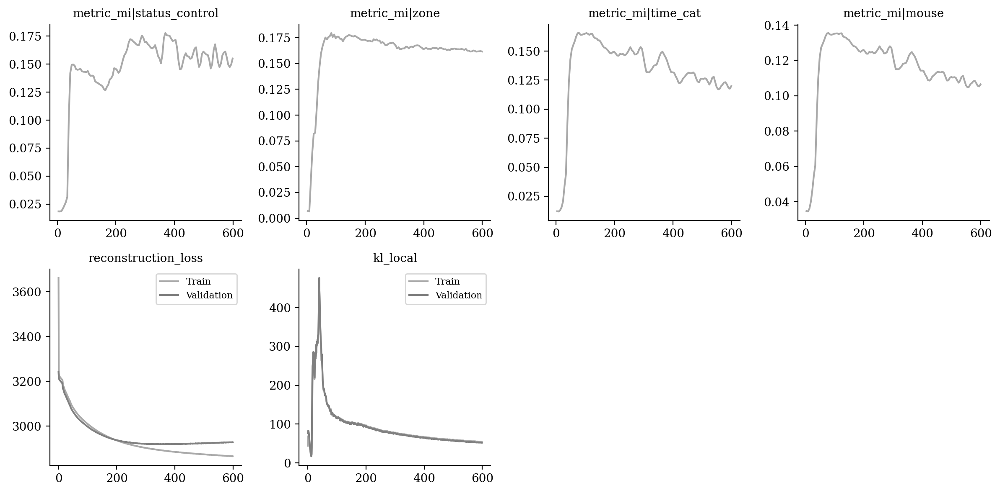

In [11]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [12]:
from tardis._disentanglementmanager import DisentanglementManager as DM

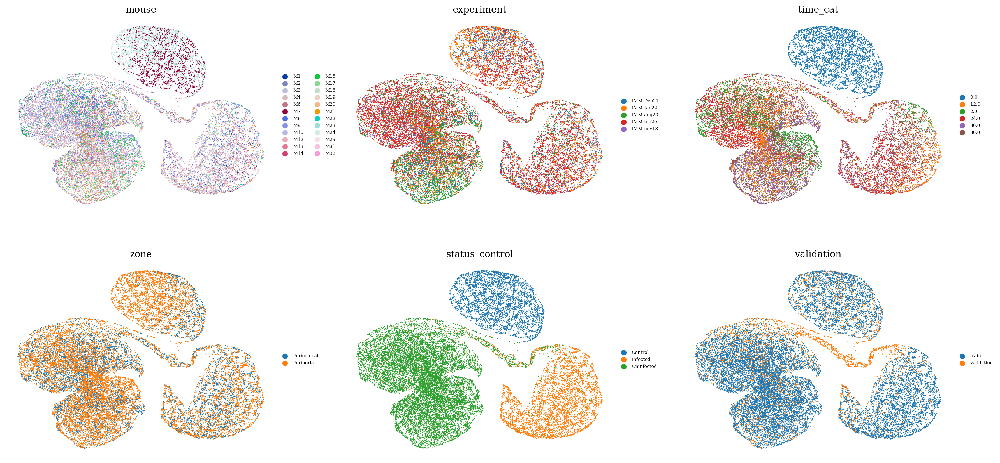

In [13]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

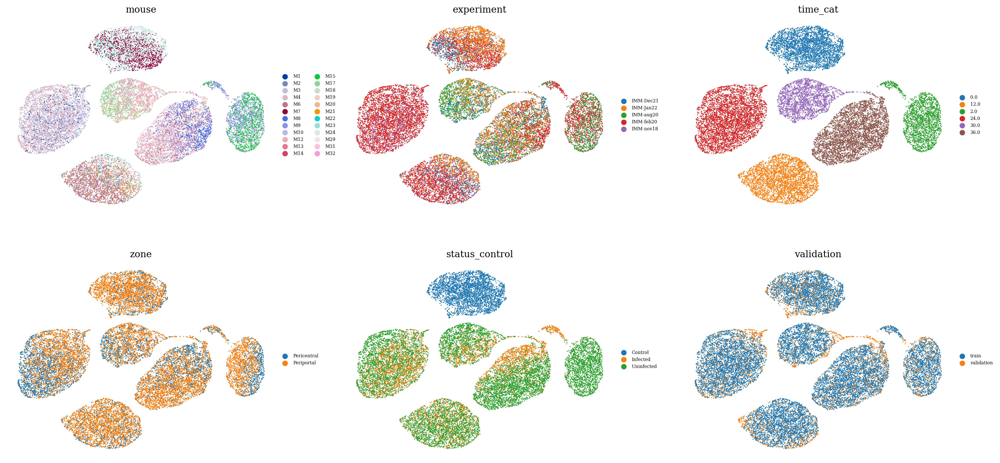

In [14]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

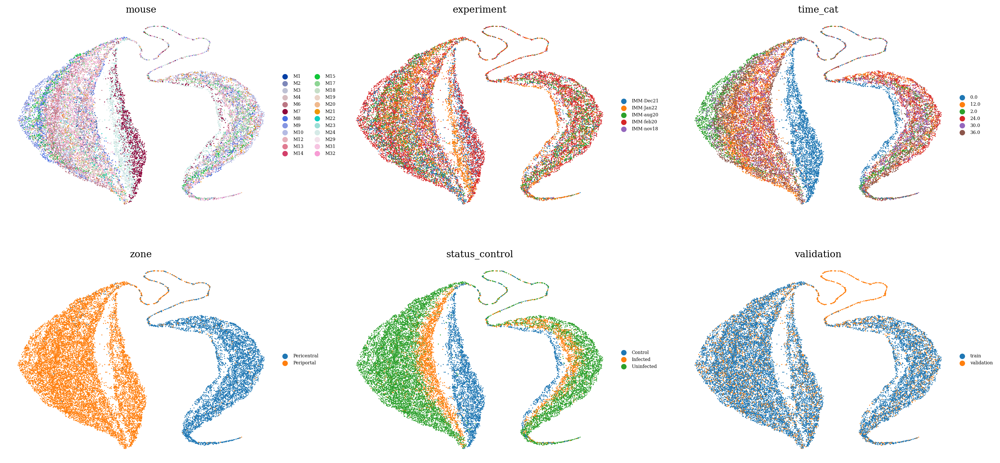

In [15]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

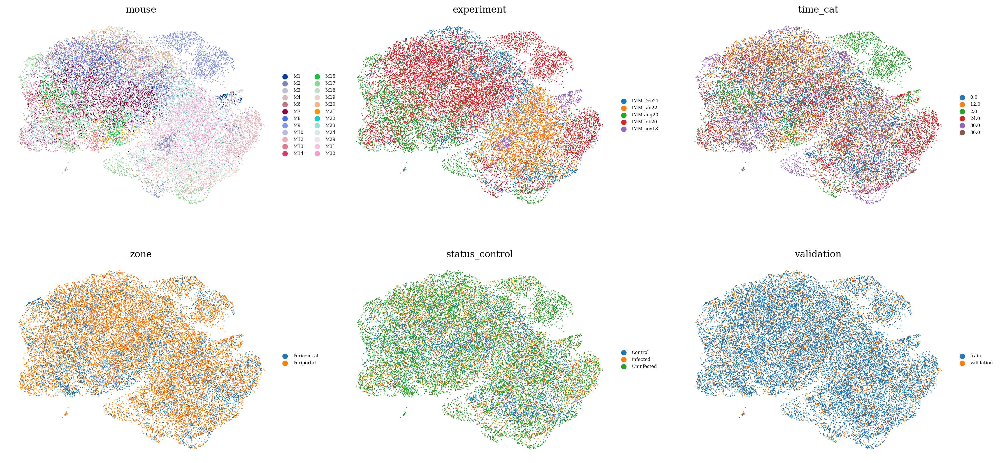

In [16]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

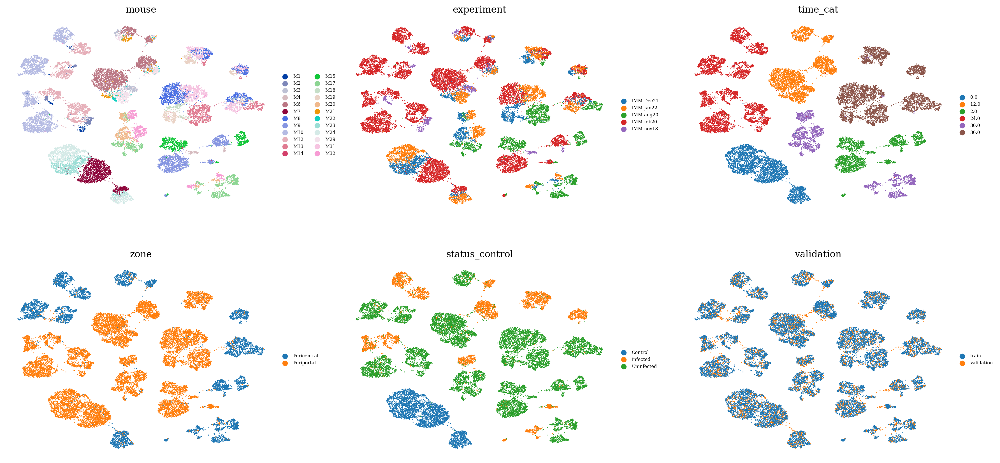

In [17]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [18]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [19]:
latent = latent[latent.obs["time_cat"] == "12.0"]

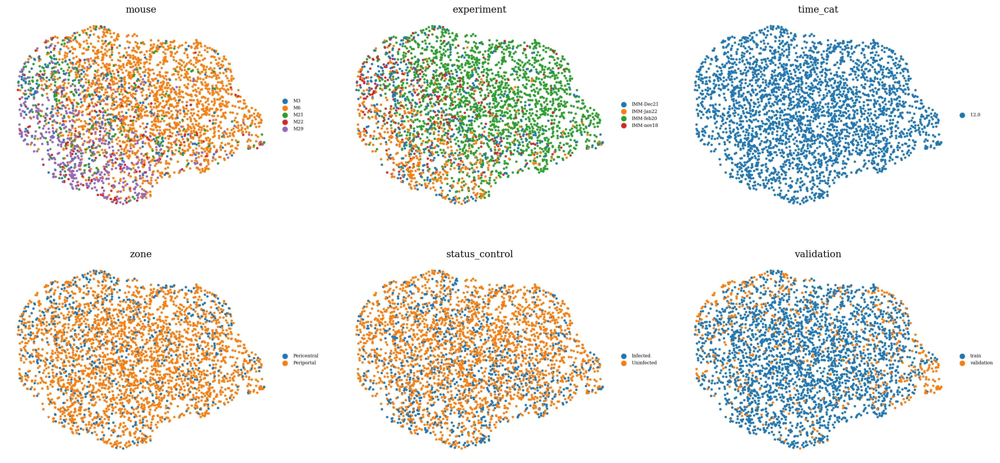

In [20]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )